In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.path as mpath
from matplotlib import rc
import matplotlib.pyplot as plt
import netCDF4 as nc 
import pandas as pd 
import xarray as xr
from xgcm import Grid
from os.path import join,expanduser
import ecco_v4_py as ecco
import seaborn as sns
import tensorflow as tf
import scipy.io
import time
import warnings
import matplotlib.colors as colors
import dask
import statsmodels.api as sm
from pyDOE import *
import matplotlib.animation as animation
from IPython.display import HTML
from functools import partial
import sys
import plotly.graph_objects as go

np.random.seed(4321)
tf.set_random_seed(4321)
print('all done')
%matplotlib inline

/home/wc4720/.conda/envs/tf114/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/wc4720/.conda/envs/tf114/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/wc4720/.conda/envs/tf114/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/wc4720/.conda/envs/tf114/lib/python3.7/site-packages

all done


In [30]:
# LOADING IN ECCO GRID + DATA

ds = xr.Dataset()
tags = ['Theta','Salt','Uvel', 'Vvel', 'Wvel', 'O2', 'NO3','MLD','DIC', 'NCP','pCO2'] # for bsose

# for i in range(1992,1993):
for tag in tags:
    with dask.config.set(**{'array.slicing.split_large_chunks': True}):
        data_path = '/projects/SOCCOM/datasets/bsose/ITER135/bsose_I135_2013to2019_monthly_'+tag+'.nc'
        dsnow = xr.open_mfdataset(data_path,chunks="auto",data_vars='minimal',coords='minimal', compat='override') 
        ds = xr.merge([ds, dsnow])
    print(tag + ' is loaded')

# make the XGCM object
xgcm_grid = Grid(ds, coords={'X': {'center': 'XC', 'left': 'XG'},
                        'Y': {'center': 'YC', 'left': 'YG'},
                        'Z': {'center': 'Z', 'left': 'Zl'} }, periodic=['X'])
# note if you want it the BSOSE grid data is also available on the website

WVELMASS_interp = xgcm_grid.interp(ds.WVEL, "Z", boundary='fill')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    vel_interp = xgcm_grid.interp_2d_vector({'X':ds.UVEL,'Y':ds.VVEL},boundary='extend')
UVEL_interp = vel_interp['X']
VVEL_interp = vel_interp['Y']

ds = xr.merge([ds, WVELMASS_interp.rename('WVEL_interp'), UVEL_interp.rename('UVEL_interp'), VVEL_interp.rename('VVEL_interp')])
ds = ds.rename({'TRAC03': 'O2','TRAC04': 'NO3','BLGMLD':'MLD','TRAC01':'DIC', 'BLGNCP':'NCP', 'BLGPCO2':'PCO2'})

ds = ds.isel(time=slice(0,12),Z=slice(0,25),Zl=slice(0,25))
ds

In [3]:
### DATA PREPROCESSING (with Navier Stokes normalization)
# note: this one (compared to ECCO) does not include the tile index so the numbers are slightly changed for dimensions and tile indices are omitted

# gets the index of the array for each dimension before flattening
def using_multiindex(A, columns):
    shape = A.shape
    index = pd.MultiIndex.from_product([range(s) for s in shape], names=columns)
    df = pd.DataFrame({'A': A.flatten()}, index=index).reset_index()
    return df

def make_nninputs(ds, tags, time_ind, depth_ind, j_ind, i_ind, N_train):
    # ds is the main ecco data array
    # tags is a list of strings corresponding to the input variables i.e. ['THETA','SALT', ...]
        # first tagged variable must be in 4d, others can be in 3d
    # tile_ind, depth_ind, j_ind, and i_ind are tuples for subsetted data
    # N_train is a number between 0 and 100 describing percentage of data sampled
    # returns inputs_nn which is an array of all the training data of size N points x [time, depth, lat, lon, tags...]
    # returns coords_nn which is an array of all the training data coordinates of size N points x [time, k, j, i]
    
    subset_template = ds[tags[0]].isel(time=slice(*time_ind),Z=slice(*depth_ind),YC=slice(*j_ind),XC=slice(*i_ind)).where(ds.maskC)
    # assuming that only one tile is chosen (OTHERWISE WILL HAVE TO CHANGE CODE)
    inputs_nn = using_multiindex(subset_template.squeeze().values, ['time', 'k', 'j', 'i']) # makes array N x 5 [time, k, j, i, *first tag*]
    inputs_nn = inputs_nn.to_numpy()
    if N_train < 100: # for validation data no need to scramble coordinates
        N_train = int(N_train/100*len(inputs_nn[:,0]))
        train_idx = np.random.choice(len(inputs_nn[:,0]), N_train, replace=False) # Generate a random sample from np.arange(N*T) of size N_train
    else: 
        train_idx = range(len(inputs_nn[:,0]))
    inputs_nn = inputs_nn[train_idx,:] # subsample the training data
    coords_nn = inputs_nn[:,0:4].astype(int) # makes the time,kji indices integers for future use
    inputs_nn = inputs_nn[:,4:] # trim array by cutting out coordinates
    
    for tag in tags:
        if len(ds[tag].shape) == 4: # it is 3d + time
            throwaway = ds[tag].where(ds.maskC).isel(time=slice(*time_ind),Z=slice(*depth_ind),YC=slice(*j_ind),XC=slice(*i_ind)).squeeze().values.flatten()[train_idx,np.newaxis]
            inputs_nn = np.concatenate((inputs_nn, throwaway),axis=1)
        elif len(ds[tag].shape) == 3: # it is 2d + time
            # throwaway = ds[tag].isel(tile=slice(*tile_ind),j=slice(*j_ind),i=slice(*i_ind)).where(ds.maskC.isel(k=slice(*depth_ind))).values
            throwaway = ds[tag].isel(YC=slice(*j_ind),XC=slice(*i_ind)).where(ds.maskC).values
            # throwaway[:,:,:,:,1:None]=np.nan # all the subsurface values become nan
            throwaway = throwaway.squeeze().flatten()[train_idx,np.newaxis]
            inputs_nn = np.concatenate((inputs_nn, throwaway),axis=1)
            
            # should OBP be on the bottom instead of the surface value?
            
    inputs_nn = inputs_nn[:,1:] # need to remove the first dummy variable
    
    # assuming that only one tile is chosen (OTHERWISE WILL HAVE TO CHANGE CODE)
    throwaway = ds.XC.isel(XC=slice(*i_ind))[coords_nn[:,3]].values.reshape(len(train_idx),1) # get lon coordinates and scale to position
    inputs_nn = np.concatenate((throwaway*111.32*1000,inputs_nn),axis=1)
    # if tile is flipped (evel not uvel), need values[1,:] for YC and values[:,1] for XC
    throwaway = ds.YC.isel(YC=slice(*j_ind))[coords_nn[:,2]].values.reshape(len(train_idx),1) # get lat coordinates and scale to position
    f_nn = 2*(2*np.pi)/86164*np.sin(throwaway*np.pi/180)
    # inputs_nn[:,0:1] = np.cos(throwaway*np.pi/180)*inputs_nn[:,0:1] # scaling the longitude length by latitude where lon = cos(lat)*lon(equator)
    inputs_nn = np.concatenate((throwaway*111.32*1000,inputs_nn),axis=1)
    throwaway = ds.Z.isel(Z=slice(*depth_ind)).values[coords_nn[:,1]].reshape(len(train_idx),1) # get depth coordinates
    inputs_nn = np.concatenate((throwaway,inputs_nn),axis=1)
    # throwaway = throwaway*-9.81 # get the hydrostatic pressure
    # inputs_nn[:,-1:] = throwaway + inputs_nn[:,-1:] # add it to the pressure anomaly
    throwaway = ds.time.isel(time=slice(*time_ind)).dt.dayofyear.values[coords_nn[:,0]].reshape(len(train_idx),1)*24*3600 # convert day of year to seconds
    inputs_nn = np.concatenate((throwaway,inputs_nn),axis=1)

    # normalize by characteristic scales
#     mean_nn = np.nanmean(inputs_nn,axis=0)
#     std_nn = np.nanstd(inputs_nn,axis=0)
#     inputs_nn = (inputs_nn - mean_nn)/std_nn

    lb_nn = np.nanmin(inputs_nn,axis=0)
    char_nn = (np.nanmax(inputs_nn,axis=0)-lb_nn)/2
    inputs_nn = (inputs_nn-lb_nn)/char_nn - 1
    
    # get rid of the nans after calculating mean + std
    inputs_nn[np.isnan(inputs_nn)] = 0
                                   
    return subset_template, inputs_nn, coords_nn, char_nn, lb_nn, f_nn

training dataset is processed!


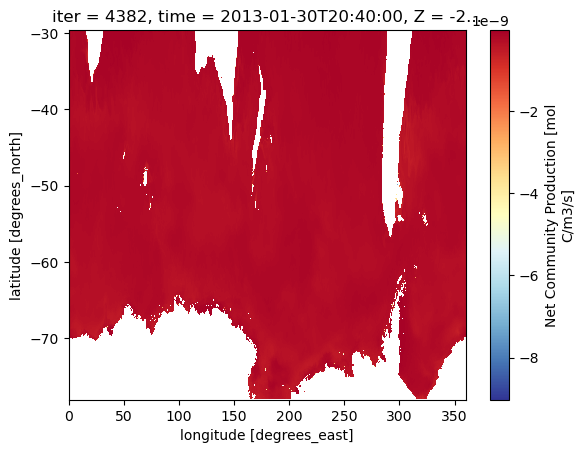

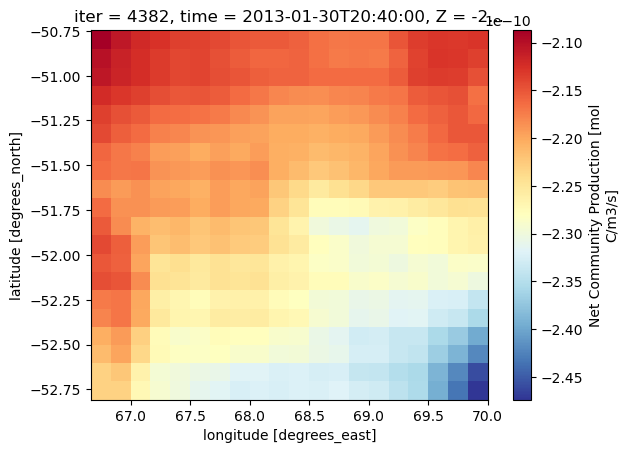

validation dataset is processed!


In [45]:
# MAKE TESTING, VALIDATION, AND TRAINING DATA

tags = ['THETA','SALT','UVEL_interp', 'VVEL_interp', 'WVEL_interp', 'O2', 'NO3','MLD','DIC']

time_ind = (0,12)
k_ind = (0,20)
j_ind = (400,420)
i_ind = (400,420)

with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    _, inputs_train, coords_train, char_train, lb_train,_ = make_nninputs(ds,tags, time_ind, k_ind, j_ind, i_ind, 5)
print('training dataset is processed!')

# plot the whole tile + training area
ds.NCP.where(ds.maskC).isel(time=0,Z=k_ind[1]).plot(x='XC',y='YC',cmap='RdYlBu_r')
plt.show()
ds.NCP.where(ds.maskC).isel(YC=slice(*j_ind),XC=slice(*i_ind),time=0,Z=k_ind[1]).plot(x='XC',y='YC',cmap='RdYlBu_r')
plt.show()

# # validation dataset
with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    subset_template, inputs_val, coords_val, char_val, lb_val, f_val = make_nninputs(ds,tags, time_ind, k_ind, j_ind, i_ind,100) 
print('validation dataset is processed!')

In [7]:
# # making the collocation points 

nCol = int(inputs_val.shape[0])
lb = -np.ones((9,)) # 8 inputs - time, z, y, x, T, S, UVEL, VVEL, WVEL
ub = np.ones((9,))
col_train = lb + (ub-lb)*lhs(9, nCol)
throwaway = (col_train[:,2]+1)*char_train[2] + lb_train[2]
f_col = 2*(2*np.pi)/86164*np.sin(throwaway*np.pi/180)
f_col = f_col.reshape((f_col.shape[0],1)).astype('float32')


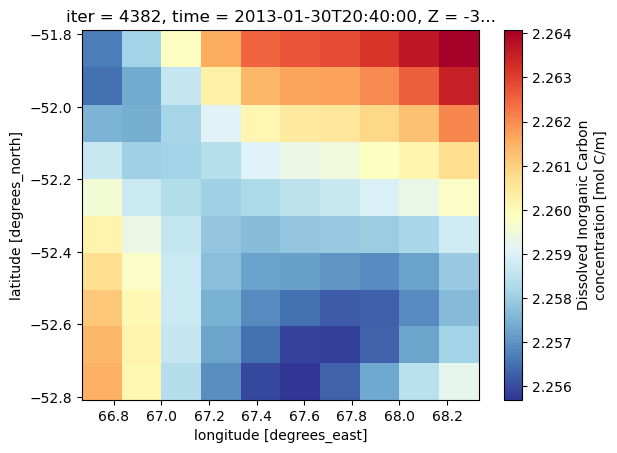

In [27]:
# np.where(coords_val[:,1] == 0)[0]
ds.DIC.where(ds.maskC).isel(YC=slice(*j_ind),XC=slice(*i_ind),time=0,Z=k_ind[1]-1).plot(x='XC',y='YC',cmap='RdYlBu_r')

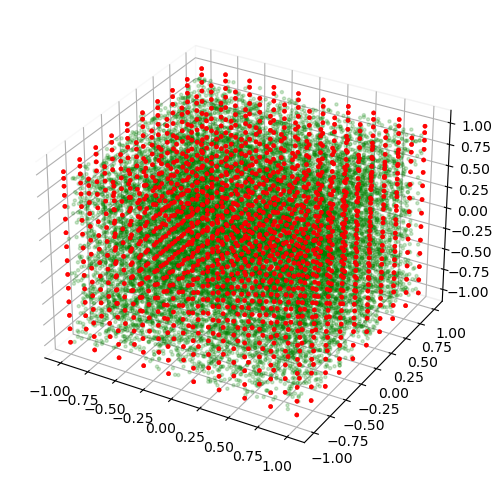

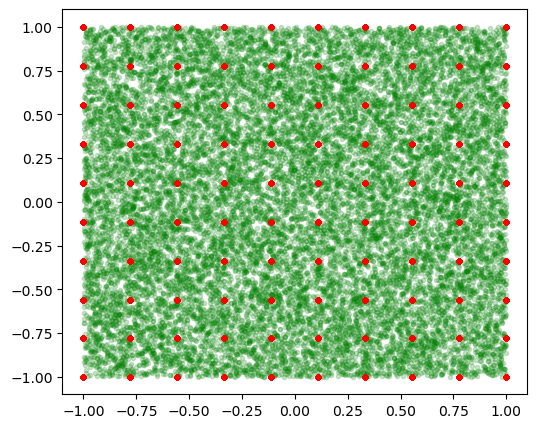

In [118]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False
ax.scatter(col_train[:,3], col_train[:,2], col_train[:,1], c='g', marker='.', alpha=0.2)
# ax.scatter(inputs_train[:,3], inputs_train[:,2], inputs_train[:,1], c='b', marker='.')
ax.scatter(inputs_val[:,3], inputs_val[:,2], inputs_val[:,1], c='r', marker='.', alpha=0.2)
plt.show()

fig = plt.figure(figsize=(6, 5))
ax = fig.add_subplot()
ax.scatter(col_train[:,3], col_train[:,2], c='g', marker='.', alpha=0.2)
ax.scatter(inputs_val[:,3], inputs_val[:,2], c='r', marker='.')
plt.show()

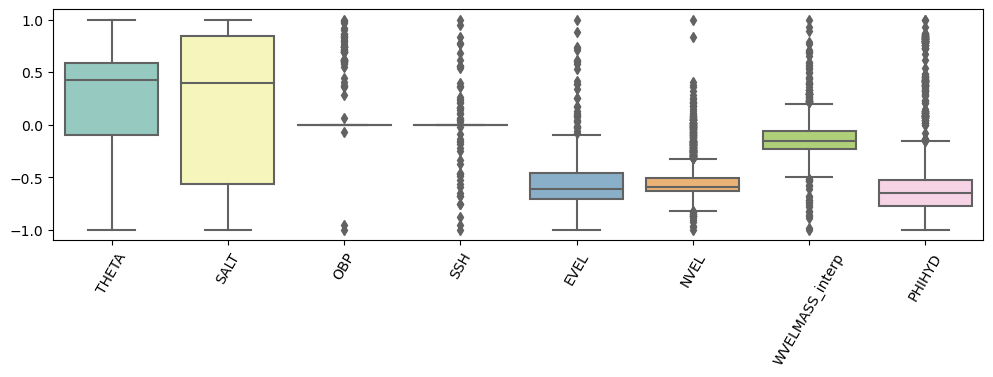

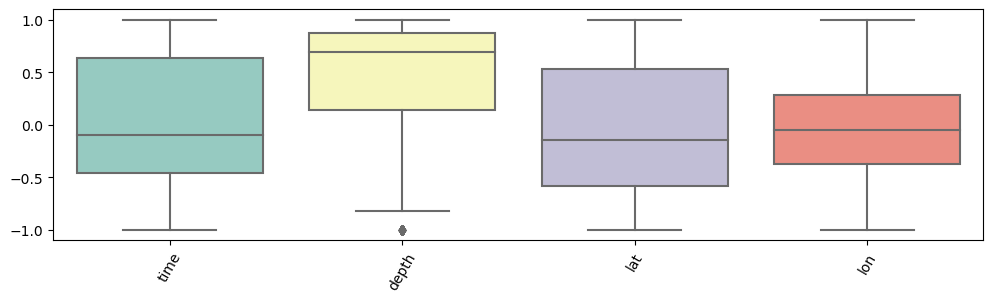

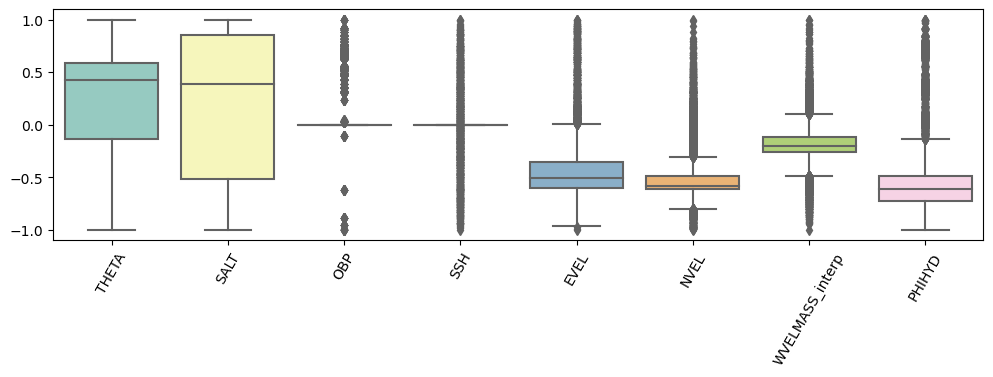

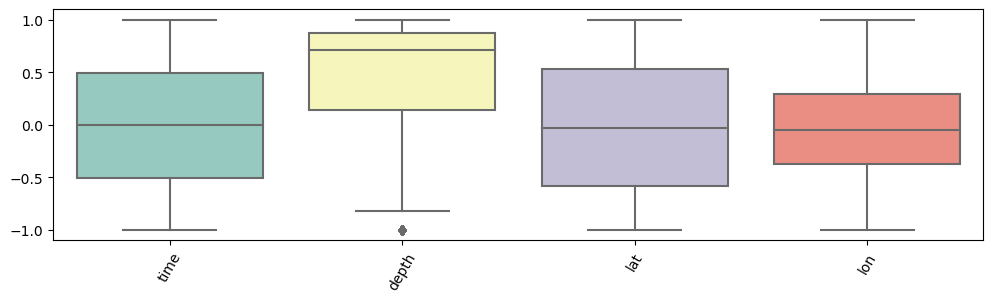

In [58]:
# # plot the normalized version of the training data

# tags = ['THETA','SALT','EVEL', 'NVEL', 'WVELMASS_interp', 'OBP','PHIHYD','SSH']
tags = ['THETA','SALT','OBP', 'SSH', 'EVEL', 'NVEL','WVELMASS_interp','PHIHYD']

fig, ax = plt.subplots(1, 1, figsize=(12,3))
ax = sns.boxplot(data=inputs_train[:,4:12], palette="Set3")
_ = ax.set_xticklabels(tags, rotation=60)
plt.show()
fig, ax = plt.subplots(1, 1, figsize=(12,3))
ax = sns.boxplot(data=inputs_train[:,0:4], palette="Set3")
_ = ax.set_xticklabels(['time','depth','lat','lon'], rotation=60)
plt.show()

# plot the normalized version of the validation data as well to make sure distributions match

fig, ax = plt.subplots(1, 1, figsize=(12,3))
ax = sns.boxplot(data=inputs_val[:,4:12], palette="Set3")
_ = ax.set_xticklabels(tags, rotation=60)
plt.show()
fig, ax = plt.subplots(1, 1, figsize=(12,3))
ax = sns.boxplot(data=inputs_val[:,0:4], palette="Set3")
_ = ax.set_xticklabels(['time','depth','lat','lon'], rotation=60)
plt.show()

In [70]:
class PhysicsInformedNN:
    # Initialize the class
    
    def __init__(self, inputs_nn, char_nn, lb_nn, col_nn, layers, f_nn):
        
        # Training points
        
        # self.res_fu = res_fu
        # self.res_fv = res_fv
        self.f_nn = f_nn
        
        X = inputs_nn[:,0:9]
                
        self.X = X
        
        self.char_nn = char_nn
        self.lb_nn = lb_nn

        self.t = inputs_nn[:,0:1]
        self.k = inputs_nn[:,1:2]
        self.j = inputs_nn[:,2:3]
        self.i = inputs_nn[:,3:4]
    
        self.T = inputs_nn[:,4:5]
        self.S = inputs_nn[:,5:6]
        self.u = inputs_nn[:,6:7]
        self.v = inputs_nn[:,7:8]
        self.w = inputs_nn[:,8:9]
        
        self.O2 = inputs_nn[:,9:10]
        self.NO3 = inputs_nn[:,10:11]
        self.MLD = inputs_nn[:,11:12]
        self.DIC = inputs_nn[:,12:13]
        
        # Collocation points
        
        self.t_c = col_nn[:,0:1]
        self.k_c = col_nn[:,1:2]
        self.j_c = col_nn[:,2:3]
        self.i_c = col_nn[:,3:4]

        self.T_c = col_nn[:,4:5]
        self.S_c = col_nn[:,5:6]
        self.u_c = col_nn[:,6:7]
        self.v_c = col_nn[:,7:8]
        self.w_c = col_nn[:,8:9]
        
        # Initialize parameters/guessed variables
        # self.Rgas = tf.Variable(initial_value = 0*self.i_c+1, shape=self.i_c.shape, dtype=tf.float32)
        # self.Rgas = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape, mean=0), dtype=tf.float32) #0.0000001
        # self.Rgas = tf.Variable([1.0], dtype=tf.float32)
        self.Rgas = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape, mean=10), dtype=tf.float32)
        self.Fairsea = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape, stddev=0.0000001), dtype=tf.float32)
        self.SNO3 = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape, stddev=0.0000001), dtype=tf.float32)
        self.K_horz = tf.Variable([1.0], dtype=tf.float32)
        self.K_vert = tf.Variable([1.0], dtype=tf.float32)
        
        self.layers = layers
        
        # Counter for the reported NS terms
        self.counter = 0
        
        # Initialize NN
        self.weights, self.biases = self.initialize_NN(layers)        
        
        # tf placeholders and graph
        self.sess = tf.Session(config=tf.ConfigProto(allow_soft_placement=True,
                                                     log_device_placement=True))
        
        # training point tf placeholders
        self.i_tf = tf.placeholder(tf.float32, shape=[None, self.i.shape[1]])
        self.j_tf = tf.placeholder(tf.float32, shape=[None, self.j.shape[1]])
        self.k_tf = tf.placeholder(tf.float32, shape=[None, self.k.shape[1]])
        self.t_tf = tf.placeholder(tf.float32, shape=[None, self.t.shape[1]])
        
        self.S_tf = tf.placeholder(tf.float32, shape=[None, self.S.shape[1]])
        self.T_tf = tf.placeholder(tf.float32, shape=[None, self.T.shape[1]])
        self.u_tf = tf.placeholder(tf.float32, shape=[None, self.u.shape[1]])
        self.v_tf = tf.placeholder(tf.float32, shape=[None, self.v.shape[1]]) 
        self.w_tf = tf.placeholder(tf.float32, shape=[None, self.w.shape[1]])
        
        self.O2_tf = tf.placeholder(tf.float32, shape=[None, self.O2.shape[1]])
        self.NO3_tf = tf.placeholder(tf.float32, shape=[None, self.NO3.shape[1]])
        self.MLD_tf = tf.placeholder(tf.float32, shape=[None, self.MLD.shape[1]])
        self.DIC_tf = tf.placeholder(tf.float32, shape=[None, self.DIC.shape[1]])
        
        # collocation point tf placeholders
        self.i_ctf = tf.placeholder(tf.float32, shape=[None, self.i_c.shape[1]])
        self.j_ctf = tf.placeholder(tf.float32, shape=[None, self.j_c.shape[1]])
        self.k_ctf = tf.placeholder(tf.float32, shape=[None, self.k_c.shape[1]])
        self.t_ctf = tf.placeholder(tf.float32, shape=[None, self.t_c.shape[1]])
    
        self.S_ctf = tf.placeholder(tf.float32, shape=[None, self.S_c.shape[1]])
        self.T_ctf = tf.placeholder(tf.float32, shape=[None, self.T_c.shape[1]])
        self.u_ctf = tf.placeholder(tf.float32, shape=[None, self.u_c.shape[1]])
        self.v_ctf = tf.placeholder(tf.float32, shape=[None, self.v_c.shape[1]])
        self.w_ctf = tf.placeholder(tf.float32, shape=[None, self.w_c.shape[1]])

        # observation points
        self.O2_pred, self.NO3_pred, self.MLD_pred, self.DIC_pred = self.net_NS(self.t_tf, self.k_tf, self.j_tf, self.i_tf, self.T_tf, self.S_tf, self.u_tf, self.v_tf, self.w_tf)
        
        # collocation points
        self.fO2, self.fNO3, self.fDIC = self.net_f_NS(self.t_ctf, self.k_ctf, self.j_ctf, self.i_ctf, self.T_ctf, self.S_ctf, self.u_ctf, self.v_ctf, self.w_ctf)
        # self.fcont, self.fz_pred, self.fv_pred, self.fu_pred, self.u_t, self.uu_x, self.vu_y, self.wu_z, self.fv, self.p_x, self.u_predictions = self.net_f_NS(self.t_ctf, self.k_ctf, self.j_ctf, self.i_ctf, self.T_ctf, self.S_ctf, self.ssh_ctf, self.obp_ctf)
        
        # losses
        self.eqloss = tf.reduce_mean(tf.square(self.fO2)) + \
                    tf.reduce_mean(tf.square(self.fNO3)) + \
                    tf.reduce_mean(tf.square(self.fDIC))
        
        # self.eqloss = tf.reduce_mean(tf.square(self.fu_pred))

        self.dataloss = tf.reduce_mean(tf.square(self.O2_tf - self.O2_pred)) + \
                    tf.reduce_mean(tf.square(self.NO3_tf - self.NO3_pred)) + \
                    tf.reduce_mean(tf.square(self.MLD_tf - self.MLD_pred)) + \
                    tf.reduce_mean(tf.square(self.DIC_tf - self.DIC_pred))

        self.loss = 0.99999*self.dataloss + 0.00001*self.eqloss    
        # saved losses
        
        self.losses = []
        self.eq_losses = []
        self.data_losses = []
        
        self.optimizer = tf.contrib.opt.ScipyOptimizerInterface(self.loss, 
                                                                method = 'L-BFGS-B', 
                                                                options = {'maxiter': 10,  # original maxiter is 50000
                                                                           'maxfun': 1e25, # might need to change depending on how large error function is
                                                                           'maxcor': 100,
                                                                           'maxls': 100,
                                                                           'ftol' : 1.0 * np.finfo(float).eps})        
        
        self.optimizer_Adam = tf.train.AdamOptimizer()
        self.train_op_Adam = self.optimizer_Adam.minimize(self.loss) 
        
        init = tf.global_variables_initializer()
        self.saver = tf.train.Saver()
        self.sess.run(init)

    def initialize_NN(self, layers): 
        weights = []
        biases = []
        num_layers = len(layers) 
        for l in range(0,num_layers-1):
            W = self.xavier_init(size=[layers[l], layers[l+1]])
            b = tf.Variable(tf.zeros([1,layers[l+1]], dtype=tf.float32), dtype=tf.float32)
            weights.append(W)
            biases.append(b)        
        return weights, biases
        
    def xavier_init(self, size):
        in_dim = size[0]
        out_dim = size[1]        
        xavier_stddev = np.sqrt(2/(in_dim + out_dim))
        # initializer = tf.variance_scaling_initializer(scale=1.0, mode='fan_in')
        return tf.Variable(tf.truncated_normal([in_dim, out_dim], stddev=xavier_stddev), dtype=tf.float32)
        # return tf.Variable(initializer(shape=(in_dim, out_dim)), dtype=tf.float32)
    
    def neural_net(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = X
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            # H = tf.keras.activations.selu(tf.add(tf.matmul(H, W), b))
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        W = weights[-1]
        b = biases[-1]
        Y = tf.add(tf.matmul(H, W), b) # linear activation function for the last layer
        return Y
        
    def net_f_NS(self, t, k, j, i, T, S, u, v, w):
        # getting equation losses on collocation points
        
        Rgas = self.Rgas
        Fairsea = self.Fairsea
        SNO3 = self.SNO3
        K_horz = self.K_horz
        K_vert = self.K_vert
        
        with tf.GradientTape(persistent=True) as tape2:
            tape2.watch(k)
            tape2.watch(j)
            tape2.watch(i)
            with tf.GradientTape(persistent=True) as tape:
                # Watch the input variables
                tape.watch(t)
                tape.watch(k)
                tape.watch(j)
                tape.watch(i)

                bgc = self.neural_net(tf.concat([t, k, j, i, T, S, u, v, w],1),self.weights,self.biases)
                O2_hat = bgc[:,0:1]
                NO3_hat = bgc[:,1:2]
                MLD_hat = bgc[:,2:3]
                DIC_hat = bgc[:,3:4]

            O2_t, O2_z, O2_y, O2_x = tape.gradient(O2_hat, [t, k, j, i])
            NO3_t, NO3_z, NO3_y, NO3_x = tape.gradient(NO3_hat, [t, k, j, i])
            DIC_t, DIC_z, DIC_y, DIC_x = tape.gradient(DIC_hat, [t, k, j, i])

        NO3_xx = tape2.gradient(NO3_x, i)
        NO3_yy = tape2.gradient(NO3_y, j)
        NO3_zz = tape2.gradient(NO3_z, k)
        O2_xx = tape2.gradient(O2_x, i)
        O2_yy = tape2.gradient(O2_y, j)
        O2_zz = tape2.gradient(O2_z, k)
        DIC_xx = tape2.gradient(DIC_x, i)
        DIC_yy = tape2.gradient(DIC_y, j)
        DIC_zz = tape2.gradient(DIC_z, k)
        
        char_nn = self.char_nn
        lb_nn = self.lb_nn

        # choose the advective time scale to non-dimensionalize the equation

#         fNO3 = NO3_t + char_nn[0]*char_nn[6]/char_nn[3]*u*NO3_x + char_nn[0]*char_nn[7]/char_nn[2]*v*NO3_y + char_nn[0]*char_nn[8]/char_nn[1]*w*NO3_z + K_horz*char_nn[0]/char_nn[3]**2*NO3_xx + K_horz*char_nn[0]/char_nn[2]**2*NO3_yy + K_vert*char_nn[0]/char_nn[1]**2*NO3_zz + char_nn[0]/char_nn[10]*SNO3
        
#         fO2 = O2_t + char_nn[0]*char_nn[6]/char_nn[3]*u*O2_x + char_nn[0]*char_nn[7]/char_nn[2]*v*O2_y + char_nn[0]*char_nn[8]/char_nn[1]*w*O2_z + K_horz*char_nn[0]/char_nn[3]**2*O2_xx + K_horz*char_nn[0]/char_nn[2]**2*O2_yy + K_vert*char_nn[0]/char_nn[1]*O2_zz - 9.5*char_nn[0]/char_nn[9]*SNO3 + char_nn[0]/char_nn[9]/char_nn[11]*Rgas*Fairsea/MLD_hat
        
#         fDIC = DIC_t + char_nn[0]*char_nn[6]/char_nn[3]*u*DIC_x + char_nn[0]*char_nn[7]/char_nn[2]*v*DIC_y + char_nn[0]*char_nn[8]/char_nn[1]*w*DIC_z + K_horz*char_nn[0]/char_nn[3]**2*DIC_xx + K_horz*char_nn[0]/char_nn[2]**2*DIC_yy + K_vert*char_nn[0]/char_nn[1]*DIC_zz  + 6.75*char_nn[0]/char_nn[12]*SNO3 + char_nn[0]/char_nn[12]/char_nn[11]*Fairsea/MLD_hat
         
        fNO3 = NO3_t + char_nn[0]*char_nn[6]/char_nn[3]*u*NO3_x + char_nn[0]*char_nn[7]/char_nn[2]*v*NO3_y + char_nn[0]*char_nn[8]/char_nn[1]*w*NO3_z + 10*char_nn[0]/char_nn[3]**2*NO3_xx + 10*char_nn[0]/char_nn[2]**2*NO3_yy + 10e-4*char_nn[0]/char_nn[1]**2*NO3_zz - char_nn[0]/char_nn[10]*SNO3
        
        fO2 = fNO3*0
        fDIC = fNO3*0
        # fO2 = O2_t + char_nn[0]*char_nn[6]/char_nn[3]*u*O2_x + char_nn[0]*char_nn[7]/char_nn[2]*v*O2_y + char_nn[0]*char_nn[8]/char_nn[1]*w*O2_z - 9.5*char_nn[0]/char_nn[9]*SNO3 + char_nn[0]/char_nn[9]/char_nn[11]*Rgas*Fairsea/MLD_hat
        
        # fDIC = DIC_t + char_nn[0]*char_nn[6]/char_nn[3]*u*DIC_x + char_nn[0]*char_nn[7]/char_nn[2]*v*DIC_y + char_nn[0]*char_nn[8]/char_nn[1]*w*DIC_z  + 6.75*char_nn[0]/char_nn[12]*SNO3 + char_nn[0]/char_nn[12]/char_nn[11]*Fairsea/MLD_hat
        
        del tape, tape2
        
        return fO2, fNO3, fDIC

    def net_NS(self, t, k, j, i, T, S, u, v, w):
        
        # getting data loss on observation points
        
        bgc = self.neural_net(tf.concat([t, k, j, i, T, S, u, v, w], 1), self.weights, self.biases)
        O2_hat = bgc[:,0:1]
        NO3_hat = bgc[:,1:2]
        MLD_hat = bgc[:,2:3]
        DIC_hat = bgc[:,3:4]
        
        return O2_hat, NO3_hat, MLD_hat, DIC_hat

    # def callback(self, loss, dataloss, eqloss, fu_pred, u_t, uu_x, vu_y, wu_z, fv, p_x, u_predictions):
    def callback(self, loss, dataloss, eqloss, K_horz, K_vert):
        callback_val = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10, mode='auto',baseline=None)
        
        if self.counter % 10 == 0:
            print('L-BFGS-B Loss: %.3e, Data loss: %.3e, Equation loss: %.3e, K_horz: %.3e, K_vert: %.3e'% (loss, dataloss, eqloss, K_horz, K_vert))
            self.losses.append(loss)
            self.eq_losses.append(eqloss)
            self.data_losses.append(dataloss)
        
        self.counter = self.counter + 1
        return callback_val
 
    def train(self, nIter): 

        tf_dict = {self.i_tf: self.i, self.j_tf: self.j, self.k_tf: self.k, self.t_tf: self.t, self.S_tf: self.S, self.T_tf: self.T, self.u_tf: self.u, self.v_tf: self.v, self.w_tf: self.w, self.O2_tf: self.O2, self.NO3_tf: self.NO3, self.MLD_tf: self.MLD, self.DIC_tf: self.DIC, \
                   self.i_ctf: self.i_c, self.j_ctf: self.j_c, self.k_ctf: self.k_c, self.t_ctf: self.t_c, self.S_ctf: self.S_c, self.T_ctf: self.T_c, self.u_ctf: self.u_c, self.v_ctf: self.v_c, self.w_ctf: self.w_c}
        
        start_time = time.time()
#         losses = np.zeros(nIter//10)
#         eq_losses = np.zeros(nIter//10)
#         data_losses = np.zeros(nIter//10)
        for it in range(nIter):
            self.sess.run(self.train_op_Adam, tf_dict)
            
            # Print
            if it % 10 == 0:
                
                loss_value = self.sess.run(self.loss, tf_dict)
                data_value = self.sess.run(self.dataloss, tf_dict)
                eq_value = self.sess.run(self.eqloss, tf_dict)
                elapsed = time.time() - start_time
                
                print('Adam It: %d, Total loss: %.3e, Data loss: %.3e, Equation loss: %.3e, Time: %.2f' % 
                      (it, loss_value, data_value, eq_value, elapsed))

                self.losses.append(loss_value)
                self.eq_losses.append(eq_value)
                self.data_losses.append(data_value)
                
        self.optimizer.minimize(self.sess,
                                feed_dict = tf_dict,
                                fetches = [self.loss, self.dataloss, self.eqloss, self.K_horz, self.K_vert],
                                # fetches = [self.loss, self.dataloss, self.eqloss, self.fv_pred, self.u_t, self.uu_x, self.vu_y, self.wu_z, self.fv, self.p_x, self.u_predictions],
#                                 loss_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3, mode='auto',verbose=2,baseline=None))
                                loss_callback = self.callback)
        
        return self.losses, self.eq_losses, self.data_losses
        # return self.losses, self.eq_losses, self.data_losses, self.fu_pred_losses, self.u_t_losses, self.uu_x_losses, self.vu_y_losses, self.wu_z_losses, self.fv_losses, self.p_x_losses, self.u_pred_losses
    
    def predict(self, t_star, k_star, j_star, i_star, T_star, S_star, u_star, v_star, w_star):
        
        tf_dict = {self.i_tf: i_star, self.j_tf: j_star, self.k_tf: k_star, self.t_tf: t_star, self.T_tf: T_star, self.S_tf: S_star, self.u_tf: u_star, self.v_tf: v_star, self.w_tf: w_star}
        
        O2_star = self.sess.run(self.O2_pred, tf_dict)
        NO3_star = self.sess.run(self.NO3_pred, tf_dict)
        MLD_star = self.sess.run(self.MLD_pred, tf_dict)
        DIC_star  = self.sess.run(self.DIC_pred, tf_dict)
        Rgas_star = self.sess.run(self.Rgas, tf_dict)
        Fairsea_star = self.sess.run(self.Fairsea, tf_dict)
        SNO3_star = self.sess.run(self.SNO3, tf_dict)
  
        return O2_star, NO3_star, MLD_star, DIC_star, Rgas_star, Fairsea_star, SNO3_star

    def compute_gradients(self, t, k, j, i, T, S, u, v, w):
        tf_dict = {self.i_tf: i, self.j_tf: j, self.k_tf: k, self.t_tf: t, self.S_tf: S, self.T_tf: T, self.u_tf: u, self.v_tf: v, self.w_tf: w}
            # Compute the outputs
        with tf.GradientTape(persistent=True) as tape:
            # Watch the input variables
            tape.watch(self.t_tf)
            tape.watch(self.k_tf)
            tape.watch(self.j_tf)
            tape.watch(self.i_tf)

            bgc = self.neural_net(tf.concat([self.t_tf, self.k_tf, self.j_tf, self.i_tf, self.T_tf, self.S_tf, self.u_tf, self.v_tf, self.w_tf], 1), self.weights, self.biases)
            O2_hat = bgc[:,0:1]
            NO3_hat = bgc[:,1:2]
            MLD_hat = bgc[:,2:3]
            DIC_hat = bgc[:,3:4]
        
            # NOTE TO SELF: HERE RESCALE EVERYTHING BACK TO NORMAL WHILE GRADIENT TAPE IS WATCHING
        
        inputs = [self.t_tf, self.k_tf, self.j_tf, self.i_tf]
#         outputs = [u_hat, v_hat, w_hat, p_hat]

        # Compute the gradients 
        gradients = [self.sess.run(tape.gradient(O2_hat, input_var),feed_dict=tf_dict) for input_var in inputs]

        # Clean up the tape
        del tape

        return gradients, self.sess.run(O2_hat,feed_dict=tf_dict)
    
    def save_model(self, save_path):
        self.saver.save(self.sess, save_path)
        print('model saved!')

In [7]:
### trying to create different sized outputs
# so far has failed because it requires different input sizes which cannot be padded 
# we can average out the NN output
# workshop this part but leave out for now

class PhysicsInformedNN:
    # Initialize the class
    
    def __init__(self, inputs_nn, char_nn, lb_nn, col_nn, layers, f_nn):
        
        # Training points
        
        # self.res_fu = res_fu
        # self.res_fv = res_fv
        self.f_nn = f_nn
        
        X = inputs_nn[:,0:9]
                
        self.X = X
        
        self.char_nn = char_nn
        self.lb_nn = lb_nn

        self.t = inputs_nn[:,0:1]
        self.k = inputs_nn[:,1:2]
        self.j = inputs_nn[:,2:3]
        self.i = inputs_nn[:,3:4]
    
        self.T = inputs_nn[:,4:5]
        self.S = inputs_nn[:,5:6]
        self.u = inputs_nn[:,6:7]
        self.v = inputs_nn[:,7:8]
        self.w = inputs_nn[:,8:9]
        
        self.O2 = inputs_nn[:,9:10]
        self.NO3 = inputs_nn[:,10:11]
        self.MLD = inputs_nn[:,11:12]
        self.DIC = inputs_nn[:,12:13]
        
        # Collocation points
        
        self.t_c = col_nn[:,0:1]
        self.k_c = col_nn[:,1:2]
        self.j_c = col_nn[:,2:3]
        self.i_c = col_nn[:,3:4]

        self.T_c = col_nn[:,4:5]
        self.S_c = col_nn[:,5:6]
        self.u_c = col_nn[:,6:7]
        self.v_c = col_nn[:,7:8]
        self.w_c = col_nn[:,8:9]
        
        # Initialize parameters/guessed variables
        # self.Rgas = tf.Variable(initial_value = 0*self.i_c+1, shape=self.i_c.shape, dtype=tf.float32)
        self.Rgas = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape), dtype=tf.float32)
        self.Fairsea = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape), dtype=tf.float32)
        self.SNO3 = tf.Variable(initial_value=tf.random.normal(shape=self.i_c.shape), dtype=tf.float32)
        # self.Rgas = tf.Variable([1.0], dtype=tf.float32)
        # self.Fairsea = tf.Variable([1.0], dtype=tf.float32)
        # self.SNO3 = tf.Variable([1.0], dtype=tf.float32)
        
        self.layers = layers
        
        # Counter for the reported NS terms
        self.counter = 0
        
        # Initialize NN
        self.weights, self.biases = self.initialize_NN(layers)        
        
        # tf placeholders and graph
        self.sess = tf.Session(config=tf.ConfigProto(allow_soft_placement=True,
                                                     log_device_placement=True))
        
        # training point tf placeholders
        self.i_tf = tf.placeholder(tf.float32, shape=[None, self.i.shape[1]])
        self.j_tf = tf.placeholder(tf.float32, shape=[None, self.j.shape[1]])
        self.k_tf = tf.placeholder(tf.float32, shape=[None, self.k.shape[1]])
        self.t_tf = tf.placeholder(tf.float32, shape=[None, self.t.shape[1]])
        
        self.S_tf = tf.placeholder(tf.float32, shape=[None, self.S.shape[1]])
        self.T_tf = tf.placeholder(tf.float32, shape=[None, self.T.shape[1]])
        self.u_tf = tf.placeholder(tf.float32, shape=[None, self.u.shape[1]])
        self.v_tf = tf.placeholder(tf.float32, shape=[None, self.v.shape[1]]) 
        self.w_tf = tf.placeholder(tf.float32, shape=[None, self.w.shape[1]])
        
        self.O2_tf = tf.placeholder(tf.float32, shape=[None, self.O2.shape[1]])
        self.NO3_tf = tf.placeholder(tf.float32, shape=[None, self.NO3.shape[1]])
        self.MLD_tf = tf.placeholder(tf.float32, shape=[None, self.MLD.shape[1]])
        self.DIC_tf = tf.placeholder(tf.float32, shape=[None, self.DIC.shape[1]])
        
        # collocation point tf placeholders
        self.i_ctf = tf.placeholder(tf.float32, shape=[None, self.i_c.shape[1]])
        self.j_ctf = tf.placeholder(tf.float32, shape=[None, self.j_c.shape[1]])
        self.k_ctf = tf.placeholder(tf.float32, shape=[None, self.k_c.shape[1]])
        self.t_ctf = tf.placeholder(tf.float32, shape=[None, self.t_c.shape[1]])
    
        self.S_ctf = tf.placeholder(tf.float32, shape=[None, self.S_c.shape[1]])
        self.T_ctf = tf.placeholder(tf.float32, shape=[None, self.T_c.shape[1]])
        self.u_ctf = tf.placeholder(tf.float32, shape=[None, self.u_c.shape[1]])
        self.v_ctf = tf.placeholder(tf.float32, shape=[None, self.v_c.shape[1]])
        self.w_ctf = tf.placeholder(tf.float32, shape=[None, self.w_c.shape[1]])

        # observation points
        self.O2_pred, self.NO3_pred, self.MLD_pred, self.DIC_pred = self.net_NS(self.t_tf, self.k_tf, self.j_tf, self.i_tf, self.T_tf, self.S_tf, self.u_tf, self.v_tf, self.w_tf)
        
        # collocation points
        self.fO2, self.fNO3, self.fDIC = self.net_f_NS(self.t_ctf, self.k_ctf, self.j_ctf, self.i_ctf, self.T_ctf, self.S_ctf, self.u_ctf, self.v_ctf, self.w_ctf)
        # self.fcont, self.fz_pred, self.fv_pred, self.fu_pred, self.u_t, self.uu_x, self.vu_y, self.wu_z, self.fv, self.p_x, self.u_predictions = self.net_f_NS(self.t_ctf, self.k_ctf, self.j_ctf, self.i_ctf, self.T_ctf, self.S_ctf, self.ssh_ctf, self.obp_ctf)
        
        # losses
        self.eqloss = tf.reduce_mean(tf.square(self.fO2)) + \
                    tf.reduce_mean(tf.square(self.fNO3)) + \
                    tf.reduce_mean(tf.square(self.fDIC))
        
        # self.eqloss = tf.reduce_mean(tf.square(self.fu_pred))

        self.dataloss = tf.reduce_mean(tf.square(self.O2_tf - self.O2_pred)) + \
                    tf.reduce_mean(tf.square(self.NO3_tf - self.NO3_pred)) + \
                    tf.reduce_mean(tf.square(self.MLD_tf - self.MLD_pred)) + \
                    tf.reduce_mean(tf.square(self.DIC_tf - self.DIC_pred))

        self.loss = self.dataloss + 0*self.eqloss    
        # saved losses
        
        self.losses = []
        self.eq_losses = []
        self.data_losses = []
        
        self.optimizer = tf.contrib.opt.ScipyOptimizerInterface(self.loss, 
                                                                method = 'L-BFGS-B', 
                                                                options = {'maxiter': 100,  # original maxiter is 50000
                                                                           'maxfun': 50000,
                                                                           'maxcor': 25,
                                                                           'maxls': 25,
                                                                           'ftol' : 1.0 * np.finfo(float).eps})        
        
        self.optimizer_Adam = tf.train.AdamOptimizer()
        self.train_op_Adam = self.optimizer_Adam.minimize(self.loss) 
        
        init = tf.global_variables_initializer()
        self.saver = tf.train.Saver()
        self.sess.run(init)

    def initialize_NN(self, layers, num_outputs): 
        weights = []
        biases = []
        num_layers = len(layers) 
        for l in range(0,num_layers-1):
            W = self.xavier_init(size=[layers[l], layers[l+1]])
            b = tf.Variable(tf.zeros([1,layers[l+1]], dtype=tf.float32), dtype=tf.float32)
            weights.append(W)
            biases.append(b)
            
        # Output layer 1
        W_output1 = self.xavier_init(size=[layers[-2], num_outputs[0]])
        b_output1 = tf.Variable(tf.zeros([1, num_outputs[0]], dtype=tf.float32), dtype=tf.float32)
        weights.append(W_output1)
        biases.append(b_output1)

        # Output layer 2 with a different size
        W_output2 = self.xavier_init(size=[layers[-2], num_outputs[1]])
        b_output2 = tf.Variable(tf.zeros([1, num_outputs[1]], dtype=tf.float32), dtype=tf.float32)
        weights.append(W_output2)
        biases.append(b_output2)
        
        return weights, biases
        
    def xavier_init(self, size):
        in_dim = size[0]
        out_dim = size[1]        
        xavier_stddev = np.sqrt(2/(in_dim + out_dim))
        # initializer = tf.variance_scaling_initializer(scale=1.0, mode='fan_in')
        return tf.Variable(tf.truncated_normal([in_dim, out_dim], stddev=xavier_stddev), dtype=tf.float32)
        # return tf.Variable(initializer(shape=(in_dim, out_dim)), dtype=tf.float32)
    
    def neural_net(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = X
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            # H = tf.keras.activations.selu(tf.add(tf.matmul(H, W), b))
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        # Output layer 1
        W_output1 = weights[-2]
        b_output1 = biases[-2]
        output1 = tf.add(tf.matmul(H, W_output1), b_output1)

        # Output layer 2 with a different size
        W_output2 = weights[-1]
        b_output2 = biases[-1]
        output2 = tf.add(tf.matmul(H, W_output2), b_output2)

        return output1, output2
        
    def net_f_NS(self, t, k, j, i, T, S, u, v, w):
        # getting equation losses on collocation points
        
        Rgas = self.Rgas
        Fairsea = self.Fairsea
        SNO3 = self.SNO3
        
        with tf.GradientTape(persistent=True) as tape:
            # Watch the input variables
            tape.watch(t)
            tape.watch(k)
            tape.watch(j)
            tape.watch(i)

            bgc, mld = self.neural_net(tf.concat([t, k, j, i, T, S, u, v, w],1),self.weights,self.biases)
            O2_hat = bgc[:,0:1]
            NO3_hat = bgc[:,1:2]
            DIC_hat = bgc[:,2:3]
            MLD_hat = mld[:,0:1]
        
        char_nn = self.char_nn
        lb_nn = self.lb_nn
        
        # f = 2*(2*np.pi)/86164*tf.math.sin(phi*np.pi/180)
        # f = 2*(2*np.pi)/86164*tf.math.sin(((j+1)*char_nn[2] + lb_nn[2])*np.pi/180)
        f = self.f_nn
        
        O2_t, O2_z, O2_y, O2_x = tape.gradient(O2_hat, [t, k, j, i])
        NO3_t, NO3_z, NO3_y, NO3_x = tape.gradient(NO3_hat, [t, k, j, i])
        DIC_t, DIC_z, DIC_y, DIC_x = tape.gradient(DIC_hat, [t, k, j, i])

        fO2 = O2_t + u*O2_x + v*O2_y + w*O2_z + SNO3
        
        fNO3 = NO3_t + u*NO3_x + v*NO3_y + w*NO3_z - 150/16*SNO3 + Rgas*Fairsea/MLD_hat
        
        fDIC = DIC_t + u*DIC_x + v*DIC_y + w*DIC_z + 106/16*SNO3 + Fairsea/MLD_hat
        
        del tape
        
        return fO2, fNO3, fDIC

    def net_NS(self, t, k, j, i, T, S, u, v, w):
        
        # getting data loss on observation points
        
        bgc, mld = self.neural_net(tf.concat([t, k, j, i, T, S, u, v, w], 1), self.weights, self.biases)
        O2_hat = bgc[:,0:1]
        NO3_hat = bgc[:,1:2]
        MLD_hat = mld[:,0:1]
        DIC_hat = bgc[:,2:3]
        
        return O2_hat, NO3_hat, MLD_hat, DIC_hat

    # def callback(self, loss, dataloss, eqloss, fu_pred, u_t, uu_x, vu_y, wu_z, fv, p_x, u_predictions):
    def callback(self, loss, dataloss, eqloss):
        callback_val = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=10, mode='auto',baseline=None)
        
        if self.counter % 10 == 0:
            print('L-BFGS-B Loss: %.3e, Data loss: %.3e, Equation loss: %.3e' % (loss, dataloss, eqloss))
            self.losses.append(loss)
            self.eq_losses.append(eqloss)
            self.data_losses.append(dataloss)
        
        self.counter = self.counter + 1
        return callback_val
 
    def train(self, nIter): 

        tf_dict = {self.i_tf: self.i, self.j_tf: self.j, self.k_tf: self.k, self.t_tf: self.t, self.S_tf: self.S, self.T_tf: self.T, self.u_tf: self.u, self.v_tf: self.v, self.w_tf: self.w, self.O2_tf: self.O2, self.NO3_tf: self.NO3, self.MLD_tf: self.MLD, self.DIC_tf: self.DIC, \
                   self.i_ctf: self.i_c, self.j_ctf: self.j_c, self.k_ctf: self.k_c, self.t_ctf: self.t_c, self.S_ctf: self.S_c, self.T_ctf: self.T_c, self.u_ctf: self.u_c, self.v_ctf: self.v_c, self.w_ctf: self.w_c}
        
        start_time = time.time()
#         losses = np.zeros(nIter//10)
#         eq_losses = np.zeros(nIter//10)
#         data_losses = np.zeros(nIter//10)
        for it in range(nIter):
            self.sess.run(self.train_op_Adam, tf_dict)
            
            # Print
            if it % 10 == 0:
                
                loss_value = self.sess.run(self.loss, tf_dict)
                data_value = self.sess.run(self.dataloss, tf_dict)
                eq_value = self.sess.run(self.eqloss, tf_dict)
                elapsed = time.time() - start_time
                
                print('Adam It: %d, Total loss: %.3e, Data loss: %.3e, Equation loss: %.3e, Time: %.2f' % 
                      (it, loss_value, data_value, eq_value, elapsed))

                self.losses.append(loss_value)
                self.eq_losses.append(eq_value)
                self.data_losses.append(data_value)
                
        self.optimizer.minimize(self.sess,
                                feed_dict = tf_dict,
                                fetches = [self.loss, self.dataloss, self.eqloss],
                                # fetches = [self.loss, self.dataloss, self.eqloss, self.fv_pred, self.u_t, self.uu_x, self.vu_y, self.wu_z, self.fv, self.p_x, self.u_predictions],
#                                 loss_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3, mode='auto',verbose=2,baseline=None))
                                loss_callback = self.callback)
        
        return self.losses, self.eq_losses, self.data_losses
        # return self.losses, self.eq_losses, self.data_losses, self.fu_pred_losses, self.u_t_losses, self.uu_x_losses, self.vu_y_losses, self.wu_z_losses, self.fv_losses, self.p_x_losses, self.u_pred_losses
    
    def predict(self, t_star, k_star, j_star, i_star, T_star, S_star, u_star, v_star, w_star):
        
        tf_dict = {self.i_tf: i_star, self.j_tf: j_star, self.k_tf: k_star, self.t_tf: t_star, self.T_tf: T_star, self.S_tf: S_star, self.u_tf: u_star, self.v_tf: v_star, self.w_tf: w_star}
        
        O2_star = self.sess.run(self.O2_pred, tf_dict)
        NO3_star = self.sess.run(self.NO3_pred, tf_dict)
        MLD_star = self.sess.run(self.MLD_pred, tf_dict)
        DIC_star  = self.sess.run(self.DIC_pred, tf_dict)
        Rgas_star = self.sess.run(self.Rgas, tf_dict)
        Fairsea_star = self.sess.run(self.Fairsea, tf_dict)
        SNO3_star = self.sess.run(self.SNO3, tf_dict)
  
        return O2_star, NO3_star, MLD_star, DIC_star, Rgas_star, Fairsea_star, SNO3_star

    def compute_gradients(self, t, k, j, i, T, S, u, v, w):
        tf_dict = {self.i_tf: i, self.j_tf: j, self.k_tf: k, self.t_tf: t, self.S_tf: S, self.T_tf: T, self.u_tf: u, self.v_tf: v, self.w_tf: w}
            # Compute the outputs
        with tf.GradientTape(persistent=True) as tape:
            # Watch the input variables
            tape.watch(self.t_tf)
            tape.watch(self.k_tf)
            tape.watch(self.j_tf)
            tape.watch(self.i_tf)

            bgc, mld = self.neural_net(tf.concat([self.t_tf, self.k_tf, self.j_tf, self.i_tf, self.T_tf, self.S_tf, self.u_tf, self.v_tf, self.w_tf], 1), self.weights, self.biases)
            O2_hat = bgc[:,0:1]
            NO3_hat = bgc[:,1:2]
            MLD_hat = mld[:,0:1]
            DIC_hat = bgc[:,2:3]
        
            # NOTE TO SELF: HERE RESCALE EVERYTHING BACK TO NORMAL WHILE GRADIENT TAPE IS WATCHING
        
        inputs = [self.t_tf, self.k_tf, self.j_tf, self.i_tf]
#         outputs = [u_hat, v_hat, w_hat, p_hat]

        # Compute the gradients 
        gradients = [self.sess.run(tape.gradient(O2_hat, input_var),feed_dict=tf_dict) for input_var in inputs]

        # Clean up the tape
        del tape

        return gradients, self.sess.run(O2_hat,feed_dict=tf_dict)
    
    def save_model(self, save_path):
        self.saver.save(self.sess, save_path)
        print('model saved!')

In [71]:
start_time2 = time.time()

if __name__ == "__main__": 
    
    layers = [9, 20, 20, 20, 20, 4] # first layer should be size of X in the PINN
    
    # model training
    # model = PhysicsInformedNN(inputs_train, char_train, lb_train, inputs_val[:,0:6].squeeze(), layers, f_val)
    model = PhysicsInformedNN(inputs_train, char_train, lb_train, inputs_val[:,0:9].squeeze(), layers, f_val)
    nIter = 500 # number of training iterations
    # losses, eq_losses, data_losses, eq_res = model.train(nIter)
    losses, eq_losses, data_losses = model.train(nIter)  # original niter is 200000

print('Total time elapsed', np.round((time.time()-start_time2)/60,3), 'minutes')

Adam It: 0, Total loss: 2.482e+08, Data loss: 1.097e+00, Equation loss: 2.482e+13, Time: 2.67
Adam It: 10, Total loss: 3.527e+07, Data loss: 5.452e-01, Equation loss: 3.527e+12, Time: 6.81
Adam It: 20, Total loss: 2.032e+07, Data loss: 2.873e-01, Equation loss: 2.032e+12, Time: 11.04
Adam It: 30, Total loss: 1.681e+06, Data loss: 2.076e-01, Equation loss: 1.681e+11, Time: 15.27
Adam It: 40, Total loss: 1.953e+04, Data loss: 1.746e-01, Equation loss: 1.953e+09, Time: 19.53
Adam It: 50, Total loss: 1.151e+05, Data loss: 1.371e-01, Equation loss: 1.151e+10, Time: 23.50
Adam It: 60, Total loss: 3.169e+04, Data loss: 1.092e-01, Equation loss: 3.169e+09, Time: 27.44
Adam It: 70, Total loss: 1.517e+02, Data loss: 8.995e-02, Equation loss: 1.516e+07, Time: 31.20
Adam It: 80, Total loss: 1.681e+04, Data loss: 7.750e-02, Equation loss: 1.681e+09, Time: 34.43
Adam It: 90, Total loss: 1.836e+04, Data loss: 7.015e-02, Equation loss: 1.836e+09, Time: 37.71
Adam It: 100, Total loss: 2.937e+03, Data l

In [72]:
### MODEL VALIDATION

if __name__ == "__main__": 
    
    t_val = inputs_val[:,0:1]
    z_val = inputs_val[:,1:2]
    y_val = inputs_val[:,2:3]
    x_val = inputs_val[:,3:4]
    T_val = inputs_val[:,4:5]
    S_val = inputs_val[:,5:6] 
    u_val = inputs_val[:,6:7]
    v_val = inputs_val[:,7:8] 
    w_val = inputs_val[:,8:9]
    O2_val = inputs_val[:,9:10]
    NO3_val = inputs_val[:,10:11]
    MLD_val = inputs_val[:,11:12]
    DIC_val = inputs_val[:,12:13]
    
    # model prediction
    O2_pred, NO3_pred, MLD_pred, DIC_pred, Rgas_pred, Fairsea_pred, SNO3_pred = model.predict(t_val, z_val, y_val, x_val, T_val, S_val, u_val, v_val, w_val)
    Kh_pred = model.sess.run(model.K_horz)
    Kv_pred = model.sess.run(model.K_vert)
    
    # error
    error_O2 = np.linalg.norm(O2_val-O2_pred,2)/np.linalg.norm(O2_val,2)
    error_NO3 = np.linalg.norm(NO3_val-NO3_pred,2)/np.linalg.norm(NO3_val,2)
    error_MLD = np.linalg.norm(MLD_val-MLD_pred,2)/np.linalg.norm(MLD_val,2)
    error_DIC = np.linalg.norm(DIC_val-DIC_pred,2)/np.linalg.norm(DIC_val,2)
    
    # error_Kh = np.abs(Kh_pred - 10)/10*100
    # error_Kv = np.abs(Kv_pred - 1e-3)/1e-3 * 100

    print('Error O2: %e' % (error_O2))    
    print('Error NO3: %e' % (error_NO3))   
    print('Error MLD: %e' % (error_MLD))  
    print('Error DIC: %e' % (error_DIC)) 
    # print('Error Kh: %e' % (error_Kh))  
    # print('Error Kv: %e' % (error_Kv)) 

Error O2: 1.386859e-01
Error NO3: 1.150319e-01
Error MLD: 2.522580e-01
Error DIC: 1.049556e-01


In [86]:
# SNO3_pred.shape

(30000, 9)

In [126]:
SNO3_pred.mean()

# ds.NPP.where(ds.maskC).isel(XC=slice(*i_ind), YC=slice(*j_ind)).mean().load()

1.7467177e-11

In [133]:
### SAVING THE MODEL

ckpt_file = "./saved-models/k1540_90data_15000iter.ckpt"
array_file = "./saved-models/k1540__90data_15000iter.npz"
model.save_model(ckpt_file)
np.savez(array_file, inputs_train=inputs_train, char_train=char_train, lb_train=lb_train, col_train = col_train, f_col = f_col, inputs_val = inputs_val, char_val = char_val, lb_val = lb_val, subset_template = subset_template, layers=layers, coords_val=coords_val, data_losses=data_losses, eq_losses=eq_losses)

# ### RELOADING THE MODEL
# loaded_data = np.load(array_file) # to load the arrays from the .npz file:

# inputs_train=loaded_data['inputs_train']
# char_train=loaded_data['char_train']
# lb_train=loaded_data['lb_train']
# col_train=loaded_data['col_train']
# layers=loaded_data['layers']
# f_col=loaded_data['f_col']

# inputs_val=loaded_data['inputs_val']
# coords_val = loaded_data['coords_val']
# char_val=loaded_data['char_val']
# lb_val=loaded_data['lb_val']
# subset_template=loaded_data['subset_template']
# layers=loaded_data['layers']

# tf.reset_default_graph()
# if __name__ == "__main__":  
#     model = PhysicsInformedNN(inputs_train, char_train, lb_train, col_train, layers, f_col)
#     model.saver.restore(model.sess, ckpt_file)
#     print('model reloaded!')

model saved!


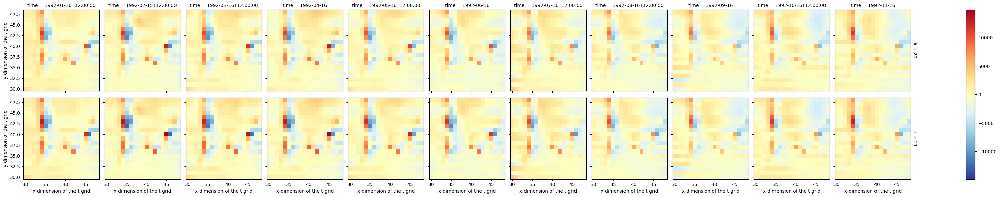

In [47]:
# f = 2*(2*np.pi)/86164*np.sin(ds_model.YC*np.pi/180)
# f = np.mean(f).values
#
# matching_rows_indices = np.where(np.all(np.array_equal(coords_val,residue[:, :coords_val.shape[1]].astype(int)), axis=-1))[0]

# np.where((x == y).all(1))[0]

# residue = char_train[3]/char_train[0]/char_train[8]*ds_eqs['U_T'] + ds_eqs['U_COMP']*ds_eqs['U_X'] + char_train[9]*char_train[3]/char_train[8]/char_train[2]*ds_eqs['V_COMP']*ds_eqs['U_Y'] + char_train[10]*char_train[3]/char_train[1]/char_train[8]*ds_eqs['W_COMP']*ds_eqs['U_Z'] - f*char_train[3]*char_train[9]/char_train[8]**2*ds_eqs['V_COMP'] + char_train[11]/char_train[8]**2*ds_eqs['P_X']
residue = char_train[3]/char_train[0]/char_train[8]*ds_eqs['U_T'] + ds_eqs['U_COMP']*ds_eqs['U_X'] + char_train[9]*char_train[3]/char_train[8]/char_train[2]*ds_eqs['V_COMP']*ds_eqs['U_Y'] + char_train[10]*char_train[3]/char_train[1]/char_train[8]*ds_eqs['W_COMP']*ds_eqs['U_Z'] + f*char_train[3]*char_train[9]/char_train[8]**2*ds_eqs['V_COMP'] + char_train[11]/char_train[8]**2*ds_eqs['P_X']
residue = residue.isel(i=slice(0,-1), j=slice(0,-1), k=slice(0,-1), time=slice(0,-1))
residue.plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r')

In [23]:
# char_train[3]/char_train[0]/char_train[8]*ds_eqs['U_T'] + ds_eqs['U_COMP']*ds_eqs['U_X'] + char_train[9]*char_train[3]/char_train[8]/char_train[2]*ds_eqs['V_COMP']*ds_eqs['U_Y'] + char_train[10]*char_train[3]/char_train[1]/char_train[8]*ds_eqs['W_COMP']*ds_eqs['U_Z'] - f*char_train[3]*char_train[9]/char_train[8]**2*ds_eqs['V_COMP'] + char_train[11]/char_train[8]**2*ds_eqs['P_X']
# char_train[11]/char_train[8]**2

char_train

array([1.44720000e+07, 6.33950043e+01, 9.27910750e+05, 1.05753950e+06,
       2.02480650e+00, 3.15746307e-01, 2.64935246e+01, 3.21211178e-01,
       1.68508634e-02, 6.77085400e-03, 2.43566615e-06, 3.35433197e+00])

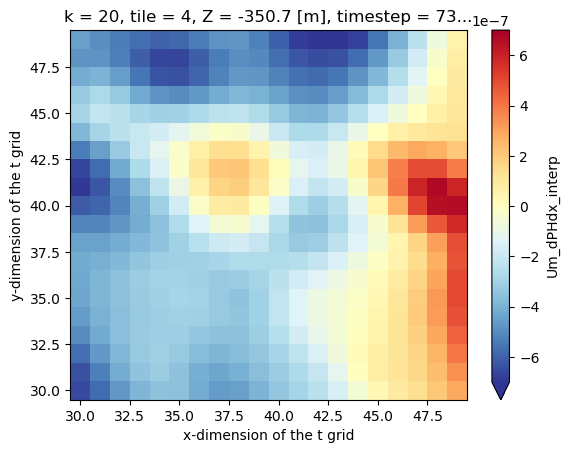

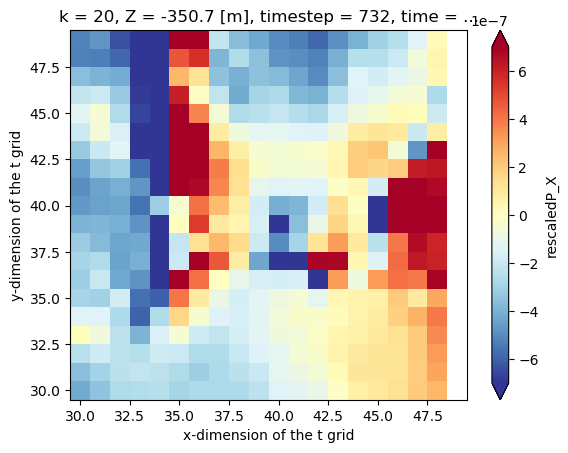

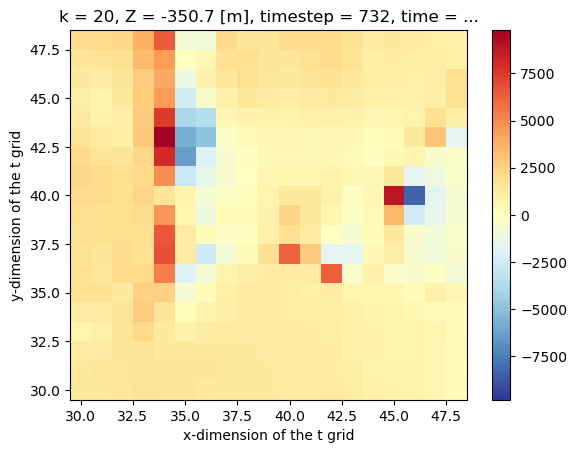

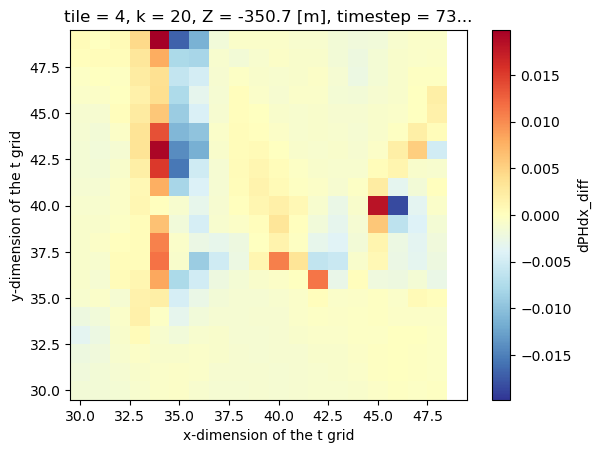

In [27]:
rescaledX = (XC_tiled+1)*char_val[3] + lb_val[3]
rescaledP = (P_COMP+1)*char_val[11] + lb_val[11]
rescaledP_X = np.ma.diff(rescaledP, axis=3).squeeze()/np.ma.diff(rescaledX, axis=3).squeeze()
rescaledP_X = np.lib.pad(rescaledP_X, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))
ds_eqs['rescaledP_X'] = (('time','k','j', 'i'), -1*rescaledP_X)

ds.Um_dPHdx_interp.where(ds.maskC).isel(tile=4,time=0,k=k_ind[0],j=slice(*j_ind),i=slice(*i_ind)).plot(x='i',y='j',cmap='RdYlBu_r',vmin=-7e-7, vmax=7e-7)
plt.show()
# ds_eqs['rescaledP_X'] = (('time','k','j', 'i'), -1*rescaledP_X)
ds_eqs.rescaledP_X.where(ds.maskC).isel(tile=4,time=0,k=0).plot(x='i',y='j',cmap='RdYlBu_r',vmin=-7e-7, vmax=7e-7)
plt.show()

ds_eqs['dPHdx_diff'] = ds.Um_dPHdx_interp - ds_eqs['rescaledP_X']
residue.isel(time=0,k=0).plot(x='i', y='j', cmap='RdYlBu_r')
plt.show()

test = ds_eqs['dPHdx_diff']*char_val[11]/char_val[8]**2

test.isel(time=0,k=0).plot(x='i', y='j', cmap='RdYlBu_r')

In [29]:
### HOW MUCH TRAINING DATA MATCHES UVEL NAVIER STOKES

# t_val = inputs_val[:,0:1]
# z_val = inputs_val[:,1:2]
# y_val = inputs_val[:,2:3]
# x_val = inputs_val[:,3:4]
# u_val = inputs_val[:,8:9]
# v_val = inputs_val[:,9:10]
# w_val = inputs_val[:,10:11]
# p_val = inputs_val[:,11:12]

# new_size = (np.unique(coords_val[:,0]).size,np.unique(coords_val[:,1]).size,np.unique(coords_val[:,2]).size,np.unique(coords_val[:,3]).size)
# ZC_tiled = z_val.reshape(new_size)
# # ZC_tiled = np.lib.pad(ZC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
# YC_tiled = y_val.reshape(new_size)
# # YC_tiled = np.lib.pad(YC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
# XC_tiled = x_val.reshape(new_size)
# # XC_tiled = np.lib.pad(XC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
# T_tiled = t_val.reshape(new_size)
# # T_tiled = np.lib.pad(T_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))

# U_COMP = u_val.reshape(new_size)
# V_COMP = v_val.reshape(new_size)
# W_COMP = w_val.reshape(new_size)
# P_COMP = p_val.reshape(new_size)
# RHO_COMP = rho_val.reshape(new_size)

# # # u_t + u*u_x + v*u_y + w*u_z - fv + p_x = 0
# u_t = np.ma.diff(U_COMP, axis=0).squeeze()/np.ma.diff(T_tiled, axis=0).squeeze()
# u_t = np.lib.pad(u_t, ((0,1),(0,0),(0,0),(0,0)), 'constant', constant_values=(np.nan))
# u_x = np.ma.diff(U_COMP, axis=3).squeeze()/np.ma.diff(XC_tiled, axis=3).squeeze()
# u_x = np.lib.pad(u_x, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))
# u_y = np.ma.diff(U_COMP, axis=2).squeeze()/np.ma.diff(YC_tiled, axis=2).squeeze()
# u_y = np.lib.pad(u_y, ((0,0),(0,0),(0,1),(0,0)), 'constant', constant_values=(np.nan))
# u_z = np.ma.diff(U_COMP, axis=1).squeeze()/np.ma.diff(ZC_tiled, axis=1).squeeze()
# u_z = np.lib.pad(u_z, ((0,0),(0,1),(0,0),(0,0)), 'constant', constant_values=(np.nan))
# p_x = np.ma.diff(P_COMP, axis=3).squeeze()/np.ma.diff(XC_tiled, axis=3).squeeze()
# p_x = np.lib.pad(p_x, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))
# # # v_t + u*v_x + v*v_y + w*v_z + fu + p_y = 0
# v_t = np.ma.diff(V_COMP, axis=0).squeeze()/np.ma.diff(T_tiled, axis=0).squeeze()
# v_t = np.lib.pad(v_t, ((0,1),(0,0),(0,0),(0,0)), 'constant', constant_values=(np.nan))
# v_x = np.ma.diff(V_COMP, axis=3).squeeze()/np.ma.diff(XC_tiled, axis=3).squeeze()
# v_x = np.lib.pad(v_x, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))
# v_y = np.ma.diff(V_COMP, axis=2).squeeze()/np.ma.diff(YC_tiled, axis=2).squeeze()
# v_y = np.lib.pad(v_y, ((0,0),(0,0),(0,1),(0,0)), 'constant', constant_values=(np.nan))
# v_z = np.ma.diff(V_COMP, axis=1).squeeze()/np.ma.diff(ZC_tiled, axis=1).squeeze()
# v_z = np.lib.pad(v_z, ((0,0),(0,1),(0,0),(0,0)), 'constant', constant_values=(np.nan))
# p_y = np.ma.diff(P_COMP, axis=2).squeeze()/np.ma.diff(YC_tiled, axis=2).squeeze()
# p_y = np.lib.pad(p_y, ((0,0),(0,0),(0,1),(0,0)), 'constant', constant_values=(np.nan))

# # f = 2*(2*np.pi)/86164*np.sin(((YC_tiled+1)*char_val[2] + lb_val[2])*np.pi/180)
# f = f_val.reshape(new_size)
# ds_eqs = xr.zeros_like(subset_template)
# # zonal momentum
# ds_eqs['U_T'] = (('time','k','j', 'i'), u_t)
# ds_eqs['U_X'] = (('time','k','j', 'i'), u_x)
# ds_eqs['U_Y'] = (('time','k','j', 'i'), u_y)
# ds_eqs['U_Z'] = (('time','k','j', 'i'), u_z)
# ds_eqs['P_X'] = (('time','k','j', 'i'), p_x)
# # meridional momentum
# ds_eqs['V_T'] = (('time','k','j', 'i'), v_t)
# ds_eqs['V_X'] = (('time','k','j', 'i'), v_x)
# ds_eqs['V_Y'] = (('time','k','j', 'i'), v_y)
# ds_eqs['V_Z'] = (('time','k','j', 'i'), v_z)
# ds_eqs['P_Y'] = (('time','k','j', 'i'), p_y)
# # ds_eqs['P_X'] = (('time','k','j', 'i'), P_COMP)
# ds_eqs['U_COMP'] = (('time','k','j', 'i'), U_COMP)
# ds_eqs['V_COMP'] = (('time','k','j', 'i'), V_COMP)
# ds_eqs['W_COMP'] = (('time','k','j', 'i'), W_COMP)
# ds_eqs['P_COMP'] = (('time','k','j', 'i'), P_COMP)
# # ds_eqs = xr.merge([ds_eqs, U_COMP, V_COMP, W_COMP, P_COMP],compat='override')

# ds_eqs = ds_eqs.reset_coords(['U_T','U_X','U_Y','U_Z','P_X','U_COMP','V_COMP','W_COMP','P_COMP']) # move from coordinate to variable
# ds_eqs = ds_eqs.reset_coords(['V_T','V_X','V_Y','V_Z','P_Y']) # move from coordinate to variable
# ds_eqs = ds_eqs.drop_vars('THETA')

residue_fu = char_val[8]/char_val[0]/f/char_val[9]*ds_eqs['U_T'] + char_val[8]**2/char_val[3]/f/char_val[9]*ds_eqs['U_COMP']*ds_eqs['U_X'] + char_val[8]/f/char_val[2]*ds_eqs['V_COMP']*ds_eqs['U_Y'] + char_val[8]*char_val[10]/char_val[1]/f/char_val[9]*ds_eqs['W_COMP']*ds_eqs['U_Z'] - ds_eqs['V_COMP'] + char_val[11]/char_val[3]/f/char_val[9]*ds_eqs['P_X']
residue_fu = residue_fu.isel(i=slice(0,-1), j=slice(0,-1), k=slice(0,-1), time=slice(0,-1))

residue_fv = char_val[9]/char_val[0]/f/char_val[8]*ds_eqs['V_T'] + char_val[9]/f/char_val[3]*ds_eqs['U_COMP']*ds_eqs['V_X'] + char_val[9]**2/f/char_val[8]/char_val[2]*ds_eqs['V_COMP']*ds_eqs['V_Y'] + char_val[10]*char_val[9]/f/char_val[1]/char_val[8]*ds_eqs['W_COMP']*ds_eqs['V_Z'] + ds_eqs['U_COMP'] + char_val[11]/f/char_val[2]/char_val[8]*ds_eqs['P_Y']
residue_fv = residue_fv.isel(i=slice(0,-1), j=slice(0,-1), k=slice(0,-1), time=slice(0,-1))

# residue_fu.plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r')
# plt.show()
# residue_fv.plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r')
# plt.show()


# # linearize 
residue_fu = using_multiindex(residue_fu.squeeze().values, ['time', 'k', 'j', 'i'])
residue_fu = residue_fu.to_numpy()
train_idx = range(len(residue_fu[:,0]))
residue_fu = residue_fu[train_idx,:] # subsample the training data
# residue = residue[:,4:] # trim array by cutting out coordinates
residue_fu[np.isnan(residue_fu)] = 0

residue_fv = using_multiindex(residue_fv.squeeze().values, ['time', 'k', 'j', 'i'])
residue_fv = residue_fv.to_numpy()
train_idx = range(len(residue_fv[:,0]))
residue_fv = residue_fv[train_idx,:] # subsample the training data
# residue = residue[:,4:] # trim array by cutting out coordinates
residue_fv[np.isnan(residue_fv)] = 0

# get indices of the residue points in linearized form
res = (coords_val[:,None] == residue_fu[:, :coords_val.shape[1]].astype(int)).all(-1).any(-1)
res = np.where(res)

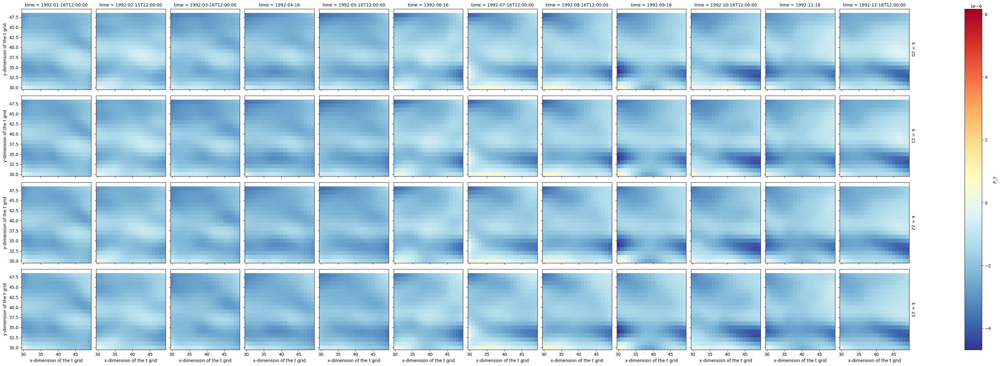

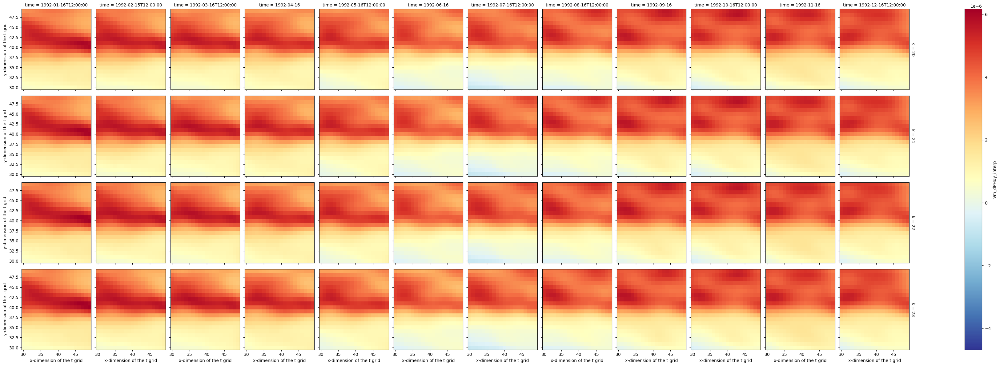

In [22]:
### HOW MUCH PRESSURE TENDENCIES ACTUALLY RESEMBLE THE DIAGNOSTIC OUTPUT 

# YC_tiled = ((y_val+1)*char_val[2] + lb_val[2]).reshape(new_size)
# P_COMP = ((p_val+1)*char_val[11] + lb_val[11]).reshape(new_size)
# XC_tiled = ((x_val+1)*char_val[3] + lb_val[3]).reshape(new_size)

# p_y = np.ma.diff(P_COMP, axis=2).squeeze()/np.ma.diff(YC_tiled, axis=2).squeeze()
# p_y = np.lib.pad(p_y, ((0,0),(0,0),(0,1),(0,0)), 'constant', constant_values=(np.nan))
# p_x = np.ma.diff(P_COMP, axis=3).squeeze()/np.ma.diff(XC_tiled, axis=3).squeeze()
# p_x = np.lib.pad(p_x, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))

# ds_eqs = xr.zeros_like(subset_template)
# ds_eqs['P_Y'] = (('time','k','j', 'i'), p_y)
# ds_eqs['P_X'] = (('time','k','j', 'i'), p_x)
# ds_eqs = ds_eqs.reset_coords(['P_Y','P_X']) # move from coordinate to variable
# ds_eqs = ds_eqs.drop_vars('THETA')

vmin = min(ds_eqs['P_Y'].min(),ds['Vm_dPHdy_interp'].isel(tile=slice(*tile_ind),j=slice(*j_ind),i=slice(*i_ind),time=slice(*time_ind),k=slice(*k_ind)).min()).values
vmax = max(ds_eqs['P_Y'].max(),ds['Vm_dPHdy_interp'].isel(tile=slice(*tile_ind),j=slice(*j_ind),i=slice(*i_ind),time=slice(*time_ind),k=slice(*k_ind)).max()).values
ds_eqs['P_Y'].plot(x='i',y='j',row='k', col='time', cmap='RdYlBu_r',vmin=vmin, vmax=vmax)
plt.show()
ds['Vm_dPHdy_interp'].isel(tile=slice(*tile_ind),j=slice(*j_ind),i=slice(*i_ind),time=slice(*time_ind),k=slice(*k_ind)).plot(x='i',y='j',row='k', col='time',cmap='RdYlBu_r',vmin=vmin, vmax=vmax)
plt.show()

# residue = char_train[3]/char_train[0]/char_train[8]*ds_eqs['U_T'] + ds_eqs['U_COMP']*ds_eqs['U_X'] + char_train[9]*char_train[3]/char_train[8]/char_train[2]*ds_eqs['V_COMP']*ds_eqs['U_Y'] + char_train[10]*char_train[3]/char_train[1]/char_train[8]*ds_eqs['W_COMP']*ds_eqs['U_Z'] - f*char_train[3]*char_train[9]/char_train[8]**2*ds_eqs['V_COMP'] + char_train[11]/char_train[8]**2*ds_eqs['P_X']
# residue = residue.isel(i=slice(0,-1), j=slice(0,-1), k=slice(0,-1), time=slice(0,-1))
# residue.plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r')

In [36]:
# coords_val = ((inputs_val[:,0:4]+1)*char_val[0:4] + lb_val[0:4])
# coords_val[:,2:4] = coords_val[:,2:4]/111.32/1000
# # coords_val = coords_val.astype(int)
# coords_val

array([[ 2.63520000e+06, -5.00000000e+00, -6.17557447e+01,
         6.25000000e+01],
       [ 2.63520000e+06, -5.00000000e+00, -6.17557447e+01,
         6.35000000e+01],
       [ 2.63520000e+06, -5.00000000e+00, -6.17557447e+01,
         6.45000000e+01],
       ...,
       [ 3.15792000e+07, -1.10590503e+03, -5.72714068e+01,
         6.94999955e+01],
       [ 3.15792000e+07, -1.10590503e+03, -5.72714068e+01,
         7.05000000e+01],
       [ 3.15792000e+07, -1.10590503e+03, -5.72714068e+01,
         7.15000000e+01]])

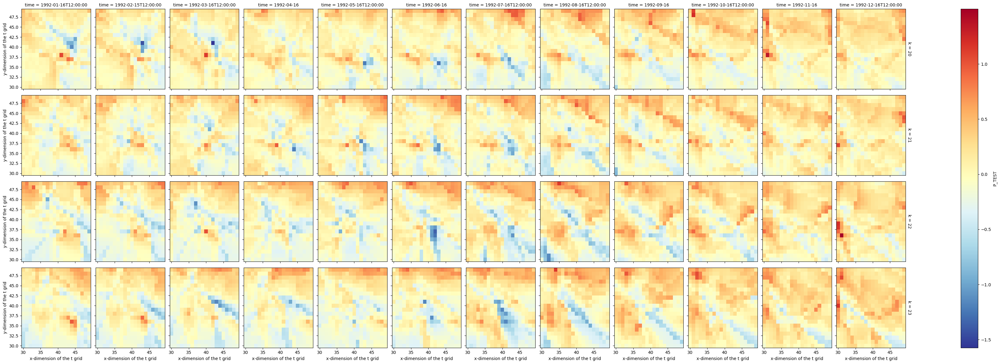

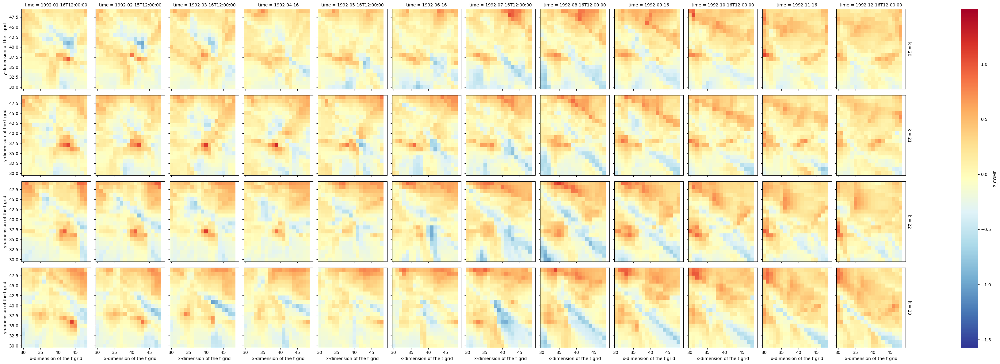

In [28]:
### WORKING GRADIENTS

# if __name__ == "__main__": 

#     all_grad, u_hat = model.compute_gradients(t_val, z_val, y_val, x_val, T_val, S_val)

P_TEST = all_grad[3].reshape(new_size)
P_TEST = np.lib.pad(P_TEST, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(0))
ds_model['P_TEST'] = (('time','k','j', 'i'), P_TEST.squeeze())
ds_model = ds_model.reset_coords(['P_TEST']) # move from coordinate to variable

# ZC_tiled = z_val.reshape(new_size)
# YC_tiled = np.lib.pad(YC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
# YC_tiled = y_val.reshape(new_size)
# YC_tiled = np.lib.pad(YC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
XC_tiled = x_val.reshape(new_size)
# XC_tiled = np.lib.pad(XC_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))
# T_tiled = t_val.reshape(new_size)
# T_tiled = np.lib.pad(T_tiled, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(np.nan))

P_COMP = u_pred.reshape(new_size)
P_COMP = np.lib.pad(P_COMP, ((size_offset[0],0),(0,size_offset[1]),(0,size_offset[2]),(0,size_offset[3])), 'constant', constant_values=(0))
ds_model['P_COMP'] = (('time','k','j', 'i'), P_COMP.squeeze())
ds_model['P_COMP'] = ds_model['P_COMP'].where(ds.maskC.isel(tile=slice(*tile_ind),k=slice(*k_ind),j=slice(*j_ind),i=slice(*i_ind))) # nan out land
P_COMP = np.ma.diff(ds_model['P_COMP'], axis=3).squeeze()/np.ma.diff(XC_tiled, axis=3).squeeze()
P_COMP = np.lib.pad(P_COMP, ((0,0),(0,0),(0,0),(0,1)), 'constant', constant_values=(np.nan))
ds_model['P_COMP'] = (('time','k','j', 'i'), P_COMP.squeeze())

vmin = min(ds_model['P_TEST'].min(),ds_model['P_COMP'].min()).values
vmax = max(ds_model['P_TEST'].max(),ds_model['P_COMP'].max()).values
ds_model['P_TEST'].where(ds.maskC.isel(tile=slice(*tile_ind),k=slice(*k_ind),j=slice(*j_ind),i=slice(*i_ind))).isel(time=slice(0,12)).plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r',vmin=vmin, vmax=vmax)
ds_model['P_COMP'].isel(time=slice(0,12)).plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r',vmin=vmin, vmax=vmax)
# ds_model['UVEL_pred'].isel(time=slice(0,12)).plot(x='i', y='j', row='k', col='time', cmap='RdYlBu_r')

In [28]:
# analyzer = innvestigate.create_analyzer('deep_taylor',model)
# facet1err.size//20
# analyzer = innvestigate.analyzer.relevance_based.relevance_analyzer.BaselineLRPZ(model)


#"No analyzer with the name 'LRP-epsilon' could be found. All possible names are: ['input', 'random', 'gradient', 'gradient.baseline', 'input_t_gradient', 'deconvnet', 'guided_backprop', 'integrated_gradients', 'smoothgrad', 'lrp', 'lrp.z', 'lrp.z_IB', 'lrp.epsilon', 'lrp.epsilon_IB', 'lrp.w_square', 'lrp.flat', 'lrp.alpha_beta', 'lrp.alpha_2_beta_1', 'lrp.alpha_2_beta_1_IB', 'lrp.alpha_1_beta_0', 'lrp.alpha_1_beta_0_IB', 'lrp.z_plus', 'lrp.z_plus_fast', 'lrp.sequential_preset_a', 'lrp.sequential_preset_b', 'lrp.sequential_preset_a_flat', 'lrp.sequential_preset_b_flat', 'lrp.sequential_preset_b_flat_until_idx', 'deep_taylor', 'deep_taylor.bounded', 'deep_lift.wrapper', 'pattern.net', 'pattern.attribution']"

536

In [24]:
# def using_multiindex(A, columns):
#     shape = A.shape
#     index = pd.MultiIndex.from_product([range(s) for s in shape], names=columns)
#     df = pd.DataFrame({'A': A.flatten()}, index=index).reset_index()
#     return df

# def undo_multiindex(A, columns):
#     # Set the MultiIndex based on the specified columns
#     A.set_index(columns, inplace=True)
#     # Unstack the DataFrame to convert it back to a NumPy array
#     result_array = df.unstack().to_numpy()

#     return result_array
# using_multiindex(subset_template.squeeze().values, ['time', 'k', 'j', 'i'])

# unique_coordinates, indices = np.unique(col_train[:,0:5], axis=0, return_inverse=True)

# dimensions = unique_coordinates.shape[0],  # Assumes a 1D array of unique indices

# ## Create an empty 4D array filled with NaN (or any default value)

# resulting_array = np.full(dimensions + (1,), np.nan)
# resulting_array[indices, 0] = u_t[0]

# u_t, uu_x, vu_y, wu_z, fv, p_x, u_predictions 

# fig = plt.figure(figsize=(8, 6))
# ax = fig.add_subplot(111, projection='3d')
# ax.xaxis.pane.fill = False
# ax.yaxis.pane.fill = False
# ax.zaxis.pane.fill = False
# scatter = ax.scatter(col_train[:,3], col_train[:,2], col_train[:,1], c=u_predictions[30], marker='.', cmap='RdYlBu_r')
# cbar = fig.colorbar(scatter)

# fig = plt.figure(figsize=(8, 6))
# ax = fig.add_subplot(111, projection='3d')
# ax.xaxis.pane.fill = False
# ax.yaxis.pane.fill = False
# ax.zaxis.pane.fill = False
# scatter = ax.scatter(inputs_val[:,3], inputs_val[:,2], inputs_val[:,1], c=inputs_val[:,8], marker='.', cmap='RdYlBu_r')
# cbar = fig.colorbar(scatter)

# fig = plt.figure(figsize=(8, 6))
# ax = fig.add_subplot(111, projection='3d')
# plt.tricontourf(col_train[:,3], col_train[:,2], col_train[:,1],colors=u_predictions[30])

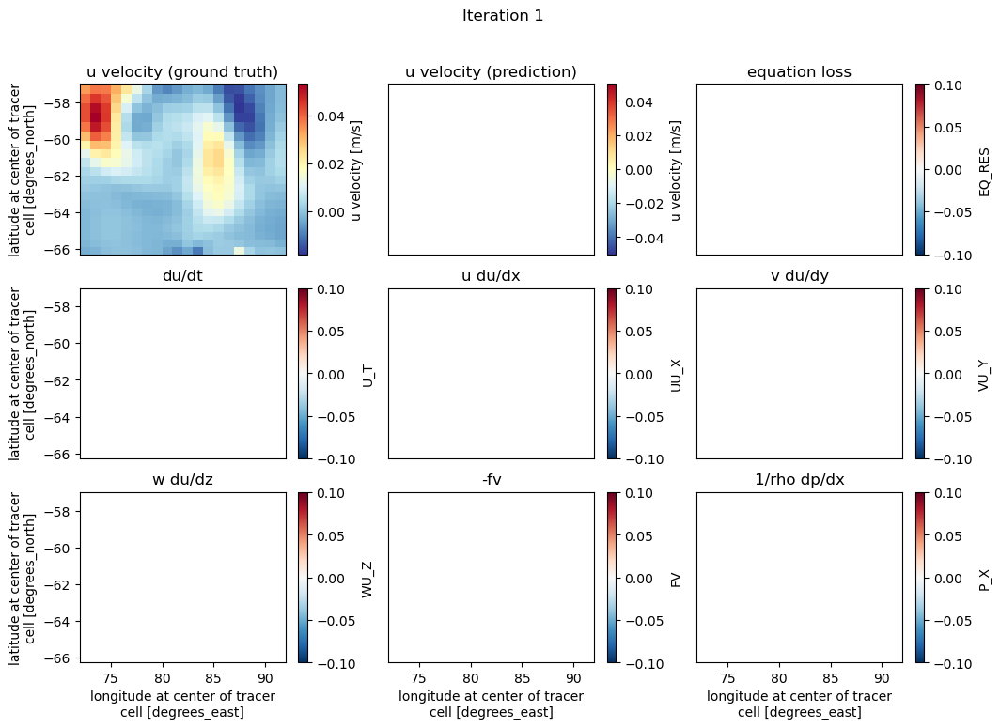

In [12]:
### Animation of different iterations

fig, ax = plt.subplots(3,3,figsize=(12,8))

# picture of ground truth
ds_model.NVEL.isel(time=0,k=0).plot(x='XC',y='YC',cmap='RdYlBu_r',vmin=ds_model.NVEL.isel(time=0,k=0).min().values,vmax=ds_model.NVEL.isel(time=0,k=0).max().values,ax=ax[0,0],cbar_kwargs={'label': 'u velocity [m/s]'})
ax[0,0].set_xlabel('')
ax[0,0].set_xticks([])
ax[0,0].set_title('u velocity (ground truth)')

# picture of the uvel
# u_map = ds_model.U_PREDICTIONS.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdYlBu_r',vmin=ds_model.NVEL.isel(time=0,k=0).min().values,vmax=ds_model.NVEL.isel(time=0,k=0).max().values,ax=ax[0,1],cbar_kwargs={'label': 'u velocity [m/s]'})
u_map = ds_model.U_PREDICTIONS.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdYlBu_r',ax=ax[0,1],cbar_kwargs={'label': 'u velocity [m/s]'})
ax[0,1].set_xlabel('')
ax[0,1].set_xticks([])
ax[0,1].set_ylabel('')
ax[0,1].set_yticks([])
ax[0,1].set_title('u velocity (prediction)')

# equation residue map
eq_map = ds_model.EQ_RES.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.EQ_RES.isel(time=0,k=0,iters=-1).min().values,vmax=ds_model.EQ_RES.isel(time=0,k=0,iters=-1).max().values,ax=ax[0,2])#,cbar_kwargs={'label': 'equation residue [m/s^2]'})
ax[0,2].set_xlabel('')
ax[0,2].set_xticks([])
ax[0,2].set_ylabel('')
ax[0,2].set_yticks([])
ax[0,2].set_title('equation loss')

# mean equation residue scatter
# facet1err = ds_model.EQ_RES.isel(time=0,k=0).mean(['i','j'])
# ax[0,1].scatter(ds_model.iteration[0], facet1err[0], s = 10, color='blue')
# ax[0,1].set_xlabel('iterations')
# # ax[1].set_ylabel('equation residue')
# ax[0,1].set_xlim([0, facet1err.size])
# ax[0,1].set_ylim([ds_model.EQ_RES.isel(time=0,k=0).min(), ds_model.EQ_RES.isel(time=0,k=0).max()])

#
u_t_map = ds_model.U_T.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.U_T.isel(time=0,k=0,iters=-1).min(), vmax=ds_model.U_T.isel(time=0,k=0,iters=-1).max(), ax=ax[1,0])#,cbar_kwargs={'label': 'du/dt [m/s^2]'})
# u_t_map = ds_model.U_T.isel(time=0,k=0,iters=500).plot(x='XC',y='YC',cmap='RdBu_r', ax=ax[1,0])#,cbar_kwargs={'label': 'du/dt [m/s^2]'})
ax[1,0].set_xlabel('')
ax[1,0].set_xticks([])
ax[1,0].set_title('du/dt')
uu_x_map = ds_model.UU_X.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.UU_X.isel(time=0,k=0,iters=-1).min(), vmax=2*ds_model.UU_X.isel(time=0,k=0,iters=-1).max(), ax=ax[1,1])#,cbar_kwargs={'label': 'udu/dx [m/s^2]'})
# uu_x_map = ds_model.UU_X.isel(time=0,k=0,iters=500).plot(x='XC',y='YC',cmap='RdBu_r', ax=ax[1,1])#,cbar_kwargs={'label': 'udu/dx [m/s^2]'})
ax[1,1].set_xlabel('')
ax[1,1].set_xticks([])
ax[1,1].set_ylabel('')
ax[1,1].set_yticks([])
ax[1,1].set_title('u du/dx')
vu_y_map = ds_model.VU_Y.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.VU_Y.isel(time=0,k=0,iters=-1).min(), vmax=2*ds_model.VU_Y.isel(time=0,k=0,iters=-1).max(), ax=ax[1,2])#,cbar_kwargs={'label': 'vdu/dy [m/s^2]'})
# vu_y_map = ds_model.VU_Y.isel(time=0,k=0,iters=500).plot(x='XC',y='YC',cmap='RdBu_r', ax=ax[1,2])#,cbar_kwargs={'label': 'vdu/dy [m/s^2]'})
ax[1,2].set_xlabel('')
ax[1,2].set_xticks([])
ax[1,2].set_ylabel('')
ax[1,2].set_yticks([])
ax[1,2].set_title('v du/dy')
wu_z_map = ds_model.WU_Z.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.WU_Z.isel(time=0,k=0,iters=-1).min(), vmax=ds_model.WU_Z.isel(time=0,k=0,iters=-1).max(), ax=ax[2,0])#,cbar_kwargs={'label': 'wdu/dz [m/s^2]'})
# wu_z_map = ds_model.WU_Z.isel(time=0,k=0,iters=500).plot(x='XC',y='YC',cmap='RdBu_r', ax=ax[2,0])#,cbar_kwargs={'label': 'wdu/dz [m/s^2]'})
ax[2,0].set_title('w du/dz')
fv_map = ds_model.FV.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.FV.isel(time=0,k=0,iters=-1).min(), vmax=ds_model.FV.isel(time=0,k=0,iters=-1).max(), ax=ax[2,1])#,cbar_kwargs={'label': 'fv [m/s^2]'})
# fv_map = ds_model.FV.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=ds_model.P_X.isel(time=0,k=0,iters=-1).min(), vmax=2*ds_model.P_X.isel(time=0,k=0,iters=-1).max(), ax=ax[2,1])#,cbar_kwargs={'label': 'fv [m/s^2]'})
ax[2,1].set_ylabel('')
ax[2,1].set_yticks([])
ax[2,1].set_title('-fv')
p_x_map = ds_model.P_X.isel(time=0,k=0,iters=0).plot(x='XC',y='YC',cmap='RdBu_r',vmin=-ds_model.FV.isel(time=0,k=0,iters=-1).max(), vmax=-ds_model.FV.isel(time=0,k=0,iters=-1).min(), ax=ax[2,2])#,cbar_kwargs={'label': '1/rho dp/dx [m/s^2]'})
# p_x_map = ds_model.P_X.isel(time=0,k=0,iters=500).plot(x='XC',y='YC',cmap='RdBu_r', ax=ax[2,2],cbar_kwargs={'label': '1/rho dp/dx [m/s^2]'})
ax[2,2].set_ylabel('')
ax[2,2].set_yticks([])
ax[2,2].set_title('1/rho dp/dx')

fig.suptitle('Iteration 1')


def animate(frame, skip):
    # change the data for each of the panels
    u_map.set_array(ds_model.U_PREDICTIONS.isel(time=0,k=0,iters=frame*skip).values.flatten())
    eq_map.set_array(ds_model.EQ_RES.isel(time=0,k=0,iters=frame*skip).values.flatten())
    u_t_map.set_array(ds_model.U_T.isel(time=0,k=0,iters=frame*skip).values.flatten())
    uu_x_map.set_array(ds_model.UU_X.isel(time=0,k=0,iters=frame*skip).values.flatten())
    vu_y_map.set_array(ds_model.VU_Y.isel(time=0,k=0,iters=frame*skip).values.flatten())
    wu_z_map.set_array(ds_model.WU_Z.isel(time=0,k=0,iters=frame*skip).values.flatten())
    fv_map.set_array(ds_model.FV.isel(time=0,k=0,iters=frame*skip).values.flatten())
    p_x_map.set_array(ds_model.P_X.isel(time=0,k=0,iters=frame*skip).values.flatten())
    
    # change iteration number
    fig.suptitle("Iteration "+str(frame*skip+1))
#     ax[1].scatter(ds_model.iteration[frame*20], facet1err[frame*20], s = 10, color='blue')

skips = 10
# ani = animation.FuncAnimation(fig, animate, (ds_model.iteration.size)//skip) # len(eq_res)
ani = animation.FuncAnimation(fig, partial(animate, skip=skips), (ds_model.iteration.size)//skips)

# ani.save('./images/all_terms.gif', writer='imagemagick', fps = 5) #Save animation as gif-file

# # display afterwards so that it doesn't mess up the gif
HTML(ani.to_jshtml()) #Show the animation in the kernel

In [36]:
ani.save('./images/iters1_1441.gif', writer='imagemagick', fps = 5) #Save animation as gif-file

In [73]:
# # PUT THE VELOCITIES INTO A NEW XARRAY

subset_template = ds.THETA.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)).where(ds.maskC)
O2_pred = (O2_pred+1)*char_train[9] + lb_train[9]
NO3_pred = (NO3_pred+1)*char_train[10] + lb_train[10]
MLD_pred = (MLD_pred+1)*char_train[11] + lb_train[11]
DIC_pred = (DIC_pred+1)*char_train[12] + lb_train[12]

# reshaping back to 4d array
new_size = (np.unique(coords_val[:,0]).size,np.unique(coords_val[:,1]).size,np.unique(coords_val[:,2]).size,np.unique(coords_val[:,3]).size) # size of the original training domain

arrays_to_change = [O2_pred, NO3_pred, MLD_pred, DIC_pred, Rgas_pred, Fairsea_pred, SNO3_pred] # no iteration data
for i in range(len(arrays_to_change)):
    arrays_to_change[i]= arrays_to_change[i].reshape(new_size)
    
# putting the predicted velocities into array to match the size of the model velocities
size_offset = np.array(subset_template.values.squeeze().shape) - np.array(arrays_to_change[0].shape)
# 'pad' the array with 0s to get it to be the same shape
# NOTE you have to change this if you mess with when the training data and testing data is

# these do not have iteration data
for i in range(len(arrays_to_change)):
    array_padding = ((size_offset[0], 0), (0, size_offset[1]), (0, size_offset[2]), (0, size_offset[3]))
    arrays_to_change[i] = np.lib.pad(arrays_to_change[i], array_padding, 'constant', constant_values=(np.nan))

# # these do have iteration data
# arrays_to_change2 = [EQ_RES, U_T, UU_X, VU_Y, WU_Z, FV, P_X, U_PREDICTIONS]
# for i in range(len(arrays_to_change2):
#     array_padding = ((size_offset[0], 0), (0, size_offset[1]), (0, size_offset[2]), (0, size_offset[3]), (0, 0))
#     arrays_to_change2[i] = np.lib.pad(arrays_to_change[i], array_padding, 'constant', constant_values=(np.nan))

# ds_model is a new xarray that contains both predicted velocities and original velocities

tags = ['O2_pred', 'NO3_pred', 'MLD_pred', 'DIC_pred','Rgas_pred','Fairsea_pred','SNO3_pred']
ds_model = xr.zeros_like(subset_template)
for i in range(len(tags)):
    ds_model[tags[i]] = (('time','Z','YC', 'XC'), arrays_to_change[i])
    ds_model[tags[i]] = ds_model[tags[i]].where(ds.maskC.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)))

# ds_model = ds_model.expand_dims(dim={'iters': len(eq_res)}) # add new dimension for model iterations
# ds_model = ds_model.assign_coords(iteration=('iters', range(len(eq_res)))) # add corresponding new coordinate
# tags2 = ['EQ_RES', 'U_T', 'UU_X', 'VU_Y', 'WU_Z', 'FV', 'P_X', 'U_PREDICTIONS']
# for i in len(tags):
#     ds_model[tags2[i]] = (('time','k','j', 'i','iters'), arrays_to_change2[i])
#     ds_model[tags2[i]] = ds_model[tags2[i]].where(ds.maskC.isel(tile=slice(*tile_ind),k=slice(*k_ind),j=slice(*j_ind),i=slice(*i_ind)))

ds_model = xr.merge([ds_model, ds.NCP.where(ds.maskC).isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)), ds.O2.where(ds.maskC).isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)),ds.where(ds.maskC).NO3.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)),ds.where(ds.maskC).MLD.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)),ds.where(ds.maskC).DIC.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)),ds.PCO2.where(ds.maskC.isel(Z=0)).isel(YC=slice(*j_ind),XC=slice(*i_ind))],compat='override')
ds_model = ds_model.reset_coords(tags) # move from coordinate to variable
# ds_model = ds_model.reset_coords(tags2) # move from coordinate to variable

# # set the differences into the output dataset 
ds_model['O2_diff'] = ds_model.O2_pred - ds_model.O2
ds_model['NO3_diff'] = ds_model.NO3_pred - ds_model.NO3
ds_model['MLD_diff'] = ds_model.MLD_pred - ds_model.MLD
ds_model['DIC_diff'] = ds_model.DIC_pred - ds_model.DIC
ds_model['O2_snr'] = ds_model.O2.std(dim='time').load()/ds_model.O2_diff.std(dim='time').load()
ds_model['NO3_snr'] = ds_model.NO3.std(dim='time').load()/ds_model.NO3_diff.std(dim='time').load()
ds_model['MLD_snr'] = ds_model.MLD.std(dim='time').load()/ds_model.MLD_diff.std(dim='time').load()
ds_model['DIC_snr'] = ds_model.DIC.std(dim='time').load()/ds_model.DIC_diff.std(dim='time').load()
print('done with this section!')

done with this section!


In [54]:
### PLOTTING FUNCTIONS
def make_a_quiver(inputs_val, char_val, lb_val, inputs_train, char_train, lb_train, u_pred, v_pred, w_pred):
    fig, axs = plt.subplots(1, 2, figsize=(16,8), subplot_kw={'projection': '3d'})
    
    ### QUIVER PLOT - TRAINING DATA

    # Color by magnitude of velocity
    
    UVEL_pred = (inputs_val[:,8:9]+1)*char_val[8] + lb_val[8]
    VVEL_pred = (inputs_val[:,9:10]+1)*char_val[9] + lb_val[9]
    WVELMASS_pred = (inputs_val[:,10:11]+1)*char_val[10] + lb_val[10]
    x_val = ((inputs_val[:,3:4]+1)*char_val[3] + lb_val[3])/111.32/1000
    y_val = ((inputs_val[:,2:3]+1)*char_val[2] + lb_val[2])/111.32/1000
    z_val = ((inputs_val[:,1:2]+1)*char_val[1] + lb_val[1])

    c = np.sqrt(UVEL_pred**2 + VVEL_pred**2 + WVELMASS_pred**2) # find magnitude of velocity
    c = (c.ravel() - c.min()) / c.ptp() # flatten and normalize
    c = np.concatenate((c, np.repeat(c, 2))) # repeat for each body line and two head lines
    c = plt.cm.RdYlBu_r(c) # colormap

    axs[0].quiver(x_val, y_val, z_val, UVEL_pred, VVEL_pred, WVELMASS_pred, length=0.3, normalize=True, colors=c, cmap='RdYlBu_r', alpha=0.4)
    # Set labels and zticks
    axs[0].set(xlabel='longitude', ylabel='latitude', zlabel='depth')
    axs[0].set_title("True velocities")

    ### QUIVER PLOT - PREDICTION

    # Color by magnitude of velocity
    UVEL_pred = (u_pred+1)*char_train[8] + lb_train[8]
    VVEL_pred = (v_pred+1)*char_train[9] + lb_train[9]
    WVELMASS_pred = (w_pred+1)*char_train[10] + lb_train[10]

    c = np.sqrt(UVEL_pred**2 + VVEL_pred**2 + WVELMASS_pred*2) # find magnitude of velocity
    c = (c.ravel() - c.min()) / c.ptp() # flatten and normalize
    c = np.concatenate((c, np.repeat(c, 2))) # repeat for each body line and two head lines
    c = plt.cm.RdYlBu_r(c) # colormap

    quivers = axs[1].quiver(x_val, y_val, z_val, UVEL_pred, VVEL_pred, WVELMASS_pred, length=0.3, normalize=True, colors=c, cmap='RdYlBu_r', alpha=0.4)
    # Set labels and zticks
    axs[1].set(xlabel='longitude', ylabel='latitude', zlabel='depth')
    axs[0].set_title("Predicted velocities")
    fig.colorbar(quivers, ax=axs.ravel().tolist())
    fig.tight_layout()
    plt.show()
    

def make_a_cube(ds_model, output_type):
    # plot a 3d cube plot of the prediction or training data
    # output type ranges from 0 to 4 for EVEL (0), NVEL (1), WVEL (2), PHIHYD (3), or RHO (4)
    # t_or_p can be training (0) or prediction (1)
    # ex: make_a_cube(ds_model, 3, 0)

    tags = [['NO3', 'O2','DIC','NCP'],
            ['NO3_pred','O2_pred','DIC_pred','SNO3_pred']]

    levels=np.linspace(min(ds_model[tags[0][output_type]].min(),ds_model[tags[1][output_type]].min()).values, max(ds_model[tags[0][output_type]].max(),ds_model[tags[1][output_type]].max()), 20)

    seismic_nanmasked = plt.get_cmap('RdYlBu_r').copy()
    seismic_nanmasked.set_bad('white')

    # Create a figure with 3D ax
    fig, axs = plt.subplots(1, 2, figsize=(18,8), subplot_kw={'projection': '3d'})

    # #Set limits of the plot from coord limits
    xmin, xmax = ds_model.XC.min(), ds_model.XC.max()
    ymin, ymax = ds_model.YC.min(), ds_model.YC.max()
    zmin, zmax = ds.Z.max(), ds.Z.min()
    for ax in axs:
        ax.xaxis.pane.fill = False
        ax.yaxis.pane.fill = False
        ax.zaxis.pane.fill = False
        ax.set(xlim=[xmin, xmax], ylim=[ymin, ymax], zlim=[zmax, zmin])
        # Plot edges
        edges_kw = dict(color='0.4', linewidth=1, zorder=1e3)
        ax.plot([xmax, xmax], [ymin, ymax], zmin, **edges_kw)
        ax.plot([xmax, xmax], [ymin, ymax], zmax, **edges_kw)
        ax.plot([xmin, xmax], [ymin, ymin], zmax, **edges_kw)
        ax.plot([xmin, xmin], [ymin, ymax], zmax, **edges_kw)
        ax.plot([xmin, xmax], [ymin, ymin], zmin, **edges_kw)
        ax.plot([xmin, xmax], [ymax, ymax], zmax, **edges_kw)
        ax.plot([xmin, xmin], [ymin, ymin], [zmin, zmax], **edges_kw)
        ax.plot([xmax, xmax], [ymax, ymax], [zmin, zmax], **edges_kw)
        ax.plot([xmax, xmax], [ymin, ymin], [zmin, zmax], **edges_kw)
        ax.plot([xmax, xmax], [ymin, ymin], [zmin, zmax], **edges_kw)
        # Set labels and zticks
        ax.set(xlabel='longitude', ylabel='latitude', zlabel='depth')

    # TRAINING DATA
    # XY plot
    axs[0].contourf(ds_model.XC.values, ds_model.YC.values, ds_model[tags[0][output_type]].isel(Z=k_ind[0],time=0).values, zdir='z', offset=ds.Z.isel(Z=k_ind[0]), cmap=seismic_nanmasked, levels=levels)
    # ax.contourf(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.YC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],time=0,k=k_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, zdir='z', offset=zmax, cmap=seismic_nanmasked, levels=levels)

    ## XZ plot
    axs[0].contourf(np.tile(ds_model.XC,(k_ind[1]-k_ind[0],1)), ds_model[tags[0][output_type]].isel(YC=0,time=0).values, np.transpose(np.tile(ds_model.Z,(i_ind[1]-i_ind[0],1))), zdir='y', offset=ymin,cmap=seismic_nanmasked, levels=levels)
    # ax.contourf(np.tile(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0]),(k_ind[1]-k_ind[0],1)), ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0],time=0).values, np.transpose(np.tile(ds.Z,(i_ind[1]-i_ind[0],1))), zdir='y', offset=ymin,cmap=seismic_nanmasked, levels=levels)

    ## YZ plot
    axs[0].contourf(ds_model[tags[0][output_type]].isel(XC=-1,time=0).values, np.tile(ds_model.YC,(k_ind[1]-k_ind[0],1)), np.transpose(np.tile(ds_model.Z,(j_ind[1]-j_ind[0],1))), zdir='x', offset=xmax,cmap=seismic_nanmasked, levels=levels)
    # axs[0].invert_zaxis()
    # PREDICTION DATA
    # XY plot
    axs[1].contourf(ds_model.XC.values, ds_model.YC.values, ds_model[tags[1][output_type]].isel(Z=k_ind[0],time=0).values, zdir='z', offset=ds.Z.isel(Z=k_ind[0]), cmap=seismic_nanmasked, levels=levels)
    # ax.contourf(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.YC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],time=0,k=k_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, zdir='z', offset=zmax, cmap=seismic_nanmasked, levels=levels)

    ## XZ plot
    axs[1].contourf(np.tile(ds_model.XC,(k_ind[1]-k_ind[0],1)), ds_model[tags[1][output_type]].isel(YC=0,time=0).values, np.transpose(np.tile(ds_model.Z,(i_ind[1]-i_ind[0],1))), zdir='y', offset=ymin,cmap=seismic_nanmasked, levels=levels)
    # ax.contourf(np.tile(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0]),(k_ind[1]-k_ind[0],1)), ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0],time=0).values, np.transpose(np.tile(ds.Z,(i_ind[1]-i_ind[0],1))), zdir='y', offset=ymin,cmap=seismic_nanmasked, levels=levels)

    ## YZ plot
    C = axs[1].contourf(ds_model[tags[1][output_type]].isel(XC=-1,time=0).values, np.tile(ds_model.YC,(k_ind[1]-k_ind[0],1)), np.transpose(np.tile(ds_model.Z,(j_ind[1]-j_ind[0],1))), zdir='x', offset=xmax,cmap=seismic_nanmasked, levels=levels)
    # axs[1].invert_zaxis()
    # Colorbar
    fig.colorbar(C, fraction=0.02, pad=0.1, label=tags[0][output_type])
    
    axs[0].set_title("True "+tags[0][output_type])
    axs[1].set_title("Predicted "+tags[0][output_type])

    # Show Figure
    fig.tight_layout()
    plt.show()

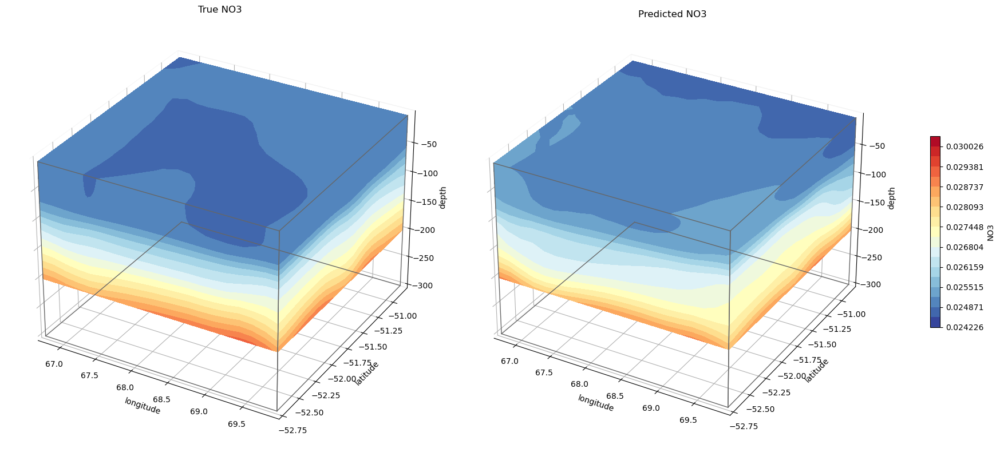

In [76]:
### TESTING THE PLOTTING FUNCTIONS
# make_a_quiver(inputs_val, char_val, lb_val, inputs_train, char_train, lb_train, u_pred, v_pred, w_pred)
make_a_cube(ds_model, 0) #['NO3', 'O2','DIC','SNO3_pred'] options

# test = np.tile(ds_model.Z,(i_ind[1]-i_ind[0],1))
# test.shape

# ds_model
# ds#.THETA.isel(Z=slice(*k_ind),YC=slice(*j_ind),XC=slice(*i_ind)).where(ds.maskC)

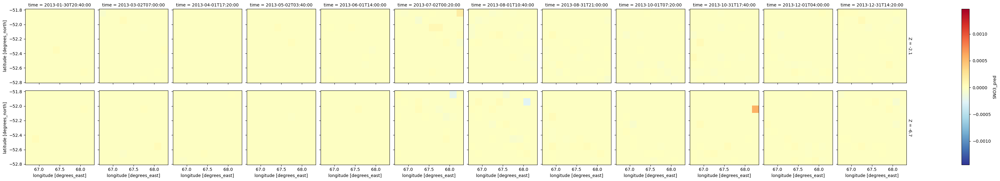

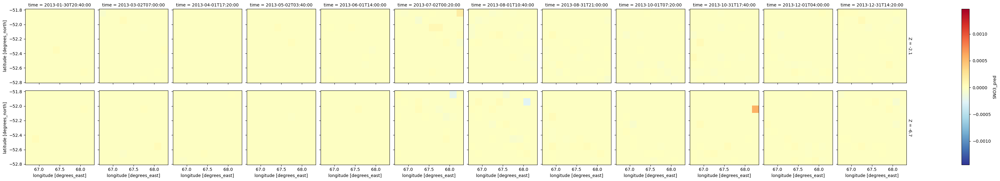

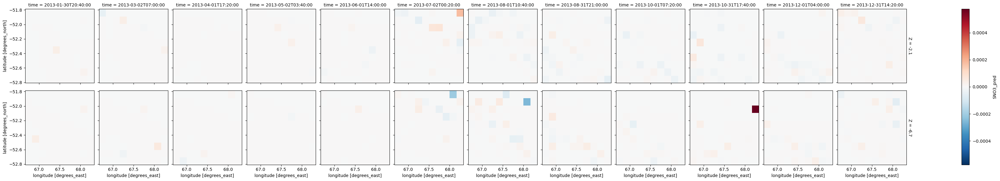

In [35]:
# make a mega plot of 4d data of zonal velocity

tags = [['O2', 'NO3','MLD','DIC','Rgas_pred','PCO2','SNO3_pred'],
        ['O2_pred','NO3_pred','MLD_pred','DIC_pred','Rgas_pred','Fairsea_pred','SNO3_pred'],
        ['O2_diff','NO3_diff','MLD_diff','DIC_diff','Rgas_pred','Fairsea_pred','SNO3_pred'],
       ['O2_snr','NO3_snr','MLD_snr','DIC_snr','Rgas_pred','Fairsea_pred','SNO3_pred']]

output_type = 6
tag_true = tags[0][output_type]
tag_pred = tags[1][output_type]
tag_diff = tags[2][output_type]
tag_snr = tags[3][output_type]

# # # each row of plots is a depth, each column is a time
vmin = min(ds_model[tag_true].min(),ds_model[tag_pred].min()).values
vmax = max(ds_model[tag_true].max(),ds_model[tag_pred].max()).values
ds_model[tag_true].isel(time=slice(*time_ind),Z=slice(k_ind[0],k_ind[0]+2)).plot(x='XC', y='YC', row ='Z',col='time', cmap='RdYlBu_r', vmin=vmin, vmax=vmax)
ds_model[tag_pred].isel(time=slice(*time_ind),Z=slice(k_ind[0],k_ind[0]+2)).plot(x='XC', y='YC', row='Z', col='time', cmap='RdYlBu_r', vmin=vmin, vmax=vmax)
# ds_model[tag_snr].plot(x='XC', y='YC', row='k',cmap='Greens')
ds_model[tag_diff].isel(time=slice(*time_ind),Z=slice(k_ind[0],k_ind[0]+2)).plot(x='XC', y='YC',row ='Z',col='time')
plt.show()


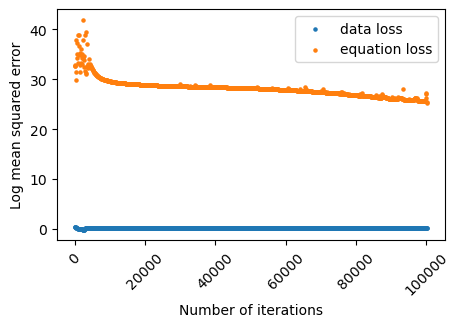

In [36]:
######## Losses after each iteration #######################
########           ########### 
fig, ax = plt.subplots(1, 1, figsize=(5,3))
iterations = list(range(0,len(data_losses)))
iterations = [i * 100 for i in iterations]
ax.scatter(iterations, np.log(data_losses), s = 5)
ax.scatter(iterations, np.log(eq_losses), s = 5)
ax.set_xlabel('Number of iterations')
ax.set_ylabel('Log mean squared error')
ax.legend(['data loss','equation loss'])
plt.xticks(rotation=45);


# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# depths = -1*ds.Z.isel(k=slice(*k_ind))
# tags = [['UVEL_pred','VVEL_pred','WVELMASS_pred','P_pred','RHO_pred'],
#         ['UVEL_diff','VVEL_diff','WVELMASS_diff','P_diff','RHO_diff']]
# for i in range(len(tags[1])): 
#     throwaway = ds_model[tags[1][i]]/ds_model[tags[0][i]] # diff/actual
#     throwaway = throwaway*throwaway
#     throwaway = throwaway.mean(['i','j','time'])
#     throwaway = np.sqrt(throwaway)*100 # RMPSE as percentage
#     ax.scatter(depths, throwaway, s = 5)
# # ax.scatter(depths, ds_model['P_diff'].mean(['i','j','time']), s = 5)
# # ax.scatter(depths, ds_model['RHO_diff'].mean(['i','j','time']), s = 5)
# ax.set_xlabel('Depths [m]')
# ax.set_ylabel('Area- and time- root mean percentage square error')
# ax.legend(['u velocity','v velocity','w velocity','pressure anom', 'density anom'])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# throwaway = ds_model['P_diff']*ds_model['P_diff']
# ax.scatter(depths, throwaway.mean(['i','j','time']), s = 5)
# throwaway = ds_model['RHO_diff']*ds_model['RHO_diff']
# ax.scatter(depths, throwaway.mean(['i','j','time']), s = 5)
# ax.set_xlabel('Depths [m]')
# ax.set_ylabel('Area- and time- MSE')
# ax.legend(['pressure anom', 'density anom'])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# iterations = list(range(0,len(data_losses)))
# ax.scatter(iterations, ds_model['U_PREDICTIONS'].isel(k=0,time=0).mean(['i','j']).squeeze(), s = 0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# plt.xticks(rotation=45);

# # each of the NS terms
# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['U_T'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['UU_X'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['VU_Y'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['WU_Z'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['FV'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);

# fig, ax = plt.subplots(1, 1, figsize=(5,3))
# # iterations = list(range(0,nIter,10))
# iterations = list(range(0,len(eq_losses)))
# # ax.scatter(iterations, eq_losses)
# ax.scatter(iterations, ds_model['P_X'].isel(k=0,time=0).mean(['i','j']).squeeze(),s=0.5)
# ax.set_xlabel('Number of iterations')
# ax.set_ylabel('Mean squared error')
# # ax.set_ylim([0,1])
# plt.xticks(rotation=45);


# #ax.set_aspect('equal', 'box')

In [60]:
ds.MLD.attrs

{'standard_name': 'BLGMLD',
 'long_name': 'Diagnosed mixed layer depth',
 'units': 'm'}

In [28]:
# # Create a figure with 6 subplot axes (for each face of the cube)
# # import plotly.subplots as sp
# from IPython.display import display

# x = np.linspace(0, 1, 20)
# y = np.linspace(0, 1, 20)
# z = np.linspace(0, 1, 20)
# t = np.linspace(0, 1, 20)

# # # Create a meshgrid for 3D plotting
# x, y, z, t = np.meshgrid(x, y, z, t)
# # t = 0*t

# fig = sp.make_subplots(
#     rows=2, cols=3,
#     specs=[[{'type': 'surface'}]*3]*2,
#     subplot_titles=['XY Plane', 'XZ Plane', 'YZ Plane', 'XT Plane', 'YT Plane', 'ZT Plane'],
#     horizontal_spacing=0.1, vertical_spacing=0.1
# )

# # Create 3D surface plots for each face
# fig.add_trace(go.Surface(x=x[:, :, 0], y=y[:, :, 0], z=z[:, :, 0], surfacecolor=t[:, :, 0], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=1, col=1)
# fig.add_trace(go.Surface(x=x[:, 0, :], y=y[:, 0, :], z=z[:, 0, :], surfacecolor=t[:, 0, :], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=1, col=2)
# fig.add_trace(go.Surface(x=x[0, :, :], y=y[0, :, :], z=z[0, :, :], surfacecolor=t[0, :, :], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=1, col=3)
# fig.add_trace(go.Surface(x=x[:, :, -1], y=y[:, :, -1], z=z[:, :, -1], surfacecolor=t[:, :, -1], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=2, col=1)
# fig.add_trace(go.Surface(x=x[:, -1, :], y=y[:, -1, :], z=z[:, -1, :], surfacecolor=t[:, -1, :], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=2, col=2)
# fig.add_trace(go.Surface(x=x[-1, :, :], y=y[-1, :, :], z=z[-1, :, :], surfacecolor=t[-1, :, :], colorscale='Viridis', cmin=np.min(t), cmax=np.max(t)), row=2, col=3)

# # fig.write_html('4D_cube_heatmap.html')
# display(fig)

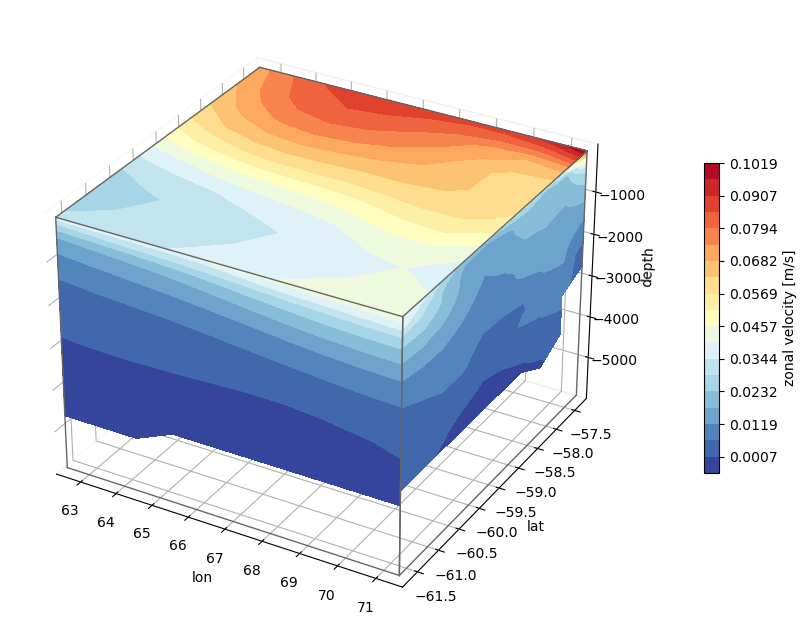

In [167]:
### 3D CUBE PLOT FOR THE OVERALL FIELD FROM DS (requires way more coordinates like j_ind etc.)

data = ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],time=0,i=slice(*i_ind), j=slice(*j_ind))
levels=np.linspace(data.min(), data.max(), 20)

seismic_nanmasked = plt.get_cmap('RdYlBu_r').copy()
seismic_nanmasked.set_bad('white')

# Create a figure with 3D ax
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# XY plot
ax.contourf(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.YC.isel(tile=tile_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],time=0,k=k_ind[0],i=slice(*i_ind), j=slice(*j_ind)).values, zdir='z', offset=zmax, cmap=seismic_nanmasked, levels=levels)
# ax.contourf(ds.XC.isel(tile=4).values, ds.YC.isel(tile=4).values, ds.EVEL.where(ds.maskC).isel(tile=4,time=0,k=40).values, zdir='z', offset=ds.Z[40],cmap=seismic_nanmasked, levels=levels)

## XZ plot
ax.contourf(np.tile(ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0]),(k_ind[1]-k_ind[0],1)), ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],i=slice(*i_ind),j=j_ind[0],time=0).values, np.transpose(np.tile(ds.Z,(i_ind[1]-i_ind[0],1))), zdir='y', offset=ymin,cmap=seismic_nanmasked, levels=levels)
# ax.contourf(np.tile(ds.XC.isel(tile=4,j=-1),(50,1)), ds.EVEL.where(ds.maskC).isel(tile=4,j=-1,time=0).values, np.transpose(np.tile(ds.Z,(90,1))), zdir='y', offset=ymax,cmap=seismic_nanmasked, levels=levels)

## YZ plot
C = ax.contourf(ds.EVEL.where(ds.maskC).isel(tile=tile_ind[0],i=i_ind[1],j=slice(*j_ind),time=0).values, np.tile(ds.YC.isel(tile=tile_ind[0],i=i_ind[1],j=slice(*j_ind)),(k_ind[1]-k_ind[0],1)), np.transpose(np.tile(ds.Z,(j_ind[1]-j_ind[0],1))), zdir='x', offset=xmax,cmap=seismic_nanmasked, levels=levels)
# C = ax.contourf(ds.EVEL.where(ds.maskC).isel(tile=4,i=0,time=0).values, np.tile(ds.YC.isel(tile=4,i=0),(50,1)), np.transpose(np.tile(ds.Z,(90,1))), zdir='x', offset=xmin,cmap=seismic_nanmasked, levels=levels)


# #Set limits of the plot from coord limits
xmin, xmax = ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind), j=j_ind[0]).min(), ds.XC.isel(tile=tile_ind[0],i=slice(*i_ind), j=j_ind[0]).max()
ymin, ymax = ds.YC.isel(tile=tile_ind[0],i=i_ind[1], j=slice(*j_ind)).min(), ds.YC.isel(tile=tile_ind[0],i=i_ind[1], j=slice(*j_ind)).max()
zmin, zmax = ds.Z.isel(k=k_ind[1]), ds.Z.isel(k=k_ind[0])
ax.set(xlim=[xmin, xmax], ylim=[ymin, ymax], zlim=[zmin, zmax])

# Plot edges
edges_kw = dict(color='0.4', linewidth=1, zorder=1e3)
ax.plot([xmax, xmax], [ymin, ymax], zmin, **edges_kw)
ax.plot([xmax, xmax], [ymin, ymax], zmax, **edges_kw)
ax.plot([xmin, xmax], [ymin, ymin], zmax, **edges_kw)
ax.plot([xmin, xmin], [ymin, ymax], zmax, **edges_kw)
ax.plot([xmin, xmax], [ymin, ymin], zmin, **edges_kw)
ax.plot([xmin, xmax], [ymax, ymax], zmax, **edges_kw)
ax.plot([xmin, xmin], [ymin, ymin], [zmin, zmax], **edges_kw)
ax.plot([xmax, xmax], [ymax, ymax], [zmin, zmax], **edges_kw)
ax.plot([xmax, xmax], [ymin, ymin], [zmin, zmax], **edges_kw)
ax.plot([xmax, xmax], [ymin, ymin], [zmin, zmax], **edges_kw)

# Set labels and zticks
ax.set(
    xlabel='lon',
    ylabel='lat',
    zlabel='depth',
)

# Set zoom and angle view
# ax.view_init(40, -30, 0)
# ax.set_box_aspect(None, zoom=0.9)

# Colorbar
fig.colorbar(C, ax=ax, fraction=0.02, pad=0.1, label='zonal velocity [m/s]')

# Show Figure
plt.show()